In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import GroupNormalization
import tensorflow_probability as tfp
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.callbacks import Callback
import numpy as np
import re
import os
import random
from tensorflow.keras.applications import InceptionV3
import PIL
from PIL import Image
import zipfile
import io
import time
from tqdm.notebook import tqdm
try:
    from kaggle_datasets import KaggleDatasets
except:
    pass

2025-05-01 19:38:18.402673: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1746128298.623831      31 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1746128298.684902      31 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
# CONSTANTS
BATCH_SIZE = 32
IMAGE_SIZE = [256, 256]
EPOCHS = 50
STEPS_PER_EPOCH = 100
FID_INTERVAL = 5  

In [3]:
# Create directories

# Create all required directories
dirs_to_create = [
    'cache',               # For dataset caching
    'cache/monet',         # Specific cache directories 
    'cache/photo',         # Specific cache directories
    'cyclegan_checkpoints',# For model checkpoints
    'generated_samples',   # For saving generated images
    'logs'                 # For tensorboard logs if needed
]

# Create each directory
for directory in dirs_to_create:
    os.makedirs(directory, exist_ok=True)
    print(f"Directory {directory} is ready")

# Function to safely use cache paths
def get_cache_path(name):
    """Returns a valid cache path for the given name, ensuring the directory exists."""
    path = os.path.join('cache', name)
    os.makedirs(path, exist_ok=True)
    return path

Directory cache is ready
Directory cache/monet is ready
Directory cache/photo is ready
Directory cyclegan_checkpoints is ready
Directory generated_samples is ready
Directory logs is ready


In [4]:
# Hardware Acceleration
try:
    # First check if TPU is available
    tpu = None
    try:
        tpu = tf.distribute.cluster_resolver.TPUClusterResolver() # TPU detection
        print('Running on TPU ', tpu.master())
    except ValueError:
        print("No TPU detected, falling back to CPU/GPU")
        
    if tpu:
        tf.config.experimental_connect_to_cluster(tpu)
        tf.tpu.experimental.initialize_tpu_system(tpu)
        strategy = tf.distribute.TPUStrategy(tpu)
        print(f"TPU detected: {tpu.master()}")
        print(f"Number of TPU cores: {strategy.num_replicas_in_sync}")
    else:
        # Default strategy that works on CPU and single GPU
        strategy = tf.distribute.get_strategy()
        
        # If GPU is available, print info about it
        gpus = tf.config.list_physical_devices('GPU')
        if gpus:
            print(f"Using GPU(s): {len(gpus)} device(s)")
            for gpu in gpus:
                print(f"  {gpu}")
            # For multi-GPU, consider using MirroredStrategy instead
            # strategy = tf.distribute.MirroredStrategy()
        else:
            print("Using CPU")
except Exception as e:
    print(f"Error setting up distribution strategy: {e}")
    print("Defaulting to basic CPU strategy")
    strategy = tf.distribute.get_strategy()

print(f"Number of replicas: {strategy.num_replicas_in_sync}")

AUTOTUNE = tf.data.experimental.AUTOTUNE

No TPU detected, falling back to CPU/GPU
Using GPU(s): 2 device(s)
  PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')
  PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU')
Number of replicas: 1


In [5]:
# Set Batch size if we have a TPU 
# (NOTE BATCH_SIZE must be divisble by 8 for 8 core TPU)
BATCH_SIZE = BATCH_SIZE * strategy.num_replicas_in_sync

In [6]:
# Load and prepare data
# data_path = 'data'

# for kaggle nb
data_path = KaggleDatasets().get_gcs_path("gan-getting-started")


MONET_JPG= tf.io.gfile.glob(str(data_path + '/monet_jpg/*.jpg'))
PHOTO_JPG = tf.io.gfile.glob(str(data_path + '/photo_jpg/*.jpg'))
MONET_TFREC = tf.io.gfile.glob(str(data_path + '/monet_tfrec/*.tfrec'))
PHOTO_TFREC = tf.io.gfile.glob(str(data_path + '/photo_tfrec/*.tfrec'))

In [7]:
def decode_image(image):
    """
    Decode JPEG: Converts raw bytes to a uint8 tensor.

    Normalize: Scales pixel values from [0, 255] to [-1, 1] (standard for GANs).

    Reshape: Forces images to 256x256x3 (CycleGAN’s default input size).
    """
    image = tf.image.decode_jpeg(image, channels=3)      # Decode JPEG bytes
    image = (tf.cast(image, tf.float32) / 127.5) - 1     # Normalize to [-1, 1]
    image = tf.reshape(image, [*IMAGE_SIZE, 3])         # Resize to 256x256
    return image

def read_tfrecord(example):
    """
    Parses a single TFRecord example to extract the image field (stored as bytes).

    Passes the bytes to decode_image for preprocessing.
    """
    tfrecord_format = {"image": tf.io.FixedLenFeature([], tf.string)}
    example = tf.io.parse_single_example(example, tfrecord_format)
    return decode_image(example['image'])

In [8]:
def load_dataset(filenames, is_tfrec=True, image_size=IMAGE_SIZE):
    """
    Load images from either TFRecords or directory of JPG/PNG files.
    
    Args:
        filenames: List of file paths (TFRecords) or directory path (for images)
        is_tfrec: Boolean flag indicating if input is TFRecords
        image_size: Target size for resizing images
    """
    if is_tfrec:
        # Handle TFRecord files
        dataset = tf.data.TFRecordDataset(filenames)
        dataset = dataset.map(
            read_tfrecord, 
            num_parallel_calls=tf.data.AUTOTUNE
        )
    else:
        # Handle JPG/PNG images from directory
        def process_image(file_path):
            img = tf.io.read_file(file_path)
            img = tf.image.decode_jpeg(img, channels=3)
            img = tf.image.resize(img, image_size)
            img = (tf.cast(img, tf.float32) / 127.5) - 1  # Normalize to [-1, 1]
            return img
        
        dataset = tf.data.Dataset.list_files(filenames + "/*.jpg")
        dataset = dataset.map(
            process_image, 
            num_parallel_calls=tf.data.AUTOTUNE
        )
    
    return dataset

# Load datasets
monet_ds = load_dataset(MONET_TFREC).batch(1)
photo_ds = load_dataset(PHOTO_TFREC).batch(1)

# Batches scaled by strategy.num_replicas_in_sync (for TPU/GPU parallelism). prefetch(32) overlaps data loading with training to avoid bottlenecks
fast_photo_ds = load_dataset(PHOTO_TFREC).batch(32*strategy.num_replicas_in_sync).prefetch(32)

# Subset (take(1024)) for Fréchet Inception Distance (FID) calculation. Larger batches (32 * replicas) for efficient evaluation.
fid_photo_ds = load_dataset(PHOTO_TFREC).take(1024).batch(32*strategy.num_replicas_in_sync).prefetch(32)
fid_monet_ds = load_dataset(MONET_TFREC).batch(32*strategy.num_replicas_in_sync).prefetch(32)

I0000 00:00:1746128315.859552      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1746128315.860233      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


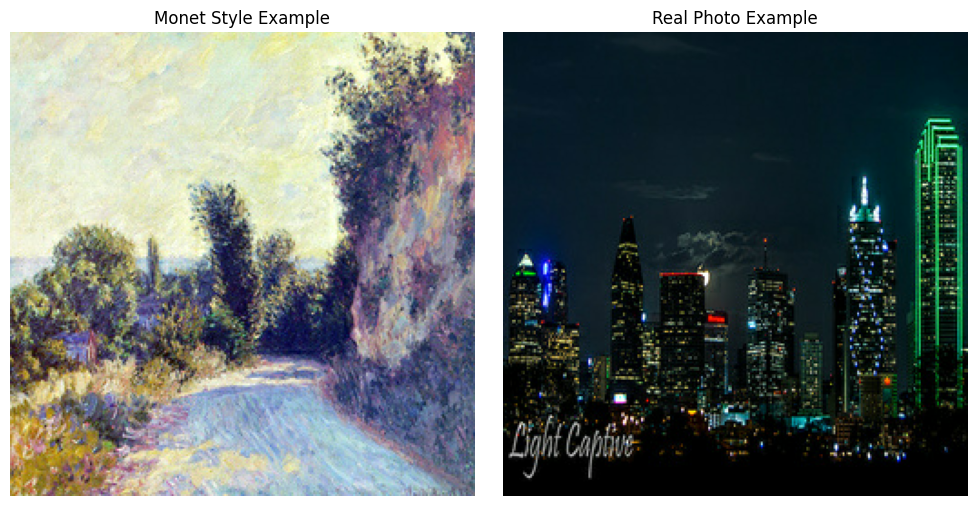

Monet image shape: (256, 256, 3)
Photo image shape: (256, 256, 3)


In [9]:
# Take one sample from each dataset
monet_sample = next(iter(monet_ds.shuffle(10)))
photo_sample = next(iter(photo_ds.shuffle(10)))

# Convert from [-1, 1] range to [0, 1] for visualization
monet_image = monet_sample[0].numpy() * 0.5 + 0.5  # [0] accesses first image in batch
photo_image = photo_sample[0].numpy() * 0.5 + 0.5

# Create subplots
plt.figure(figsize=(10, 5))

# Plot Monet painting
plt.subplot(1, 2, 1)
plt.imshow(monet_image)
plt.title("Monet Style Example")
plt.axis('off')

# Plot Photo
plt.subplot(1, 2, 2)
plt.imshow(photo_image)
plt.title("Real Photo Example")
plt.axis('off')

plt.tight_layout()
plt.show()

print("Monet image shape:", monet_image.shape)
print("Photo image shape:", photo_image.shape)

In [10]:
def get_gan_dataset(monet_files, photo_files, repeat=True, shuffle=True, batch_size=1):
    # Re-load raw datasets fully
    monet_ds = load_dataset(monet_files)
    photo_ds = load_dataset(photo_files)

    # Shuffle
    if shuffle:
        monet_ds = monet_ds.shuffle(2048)
        photo_ds = photo_ds.shuffle(2048)

    # Batch and optimize
    monet_ds = monet_ds.batch(batch_size, drop_remainder=True)
    photo_ds = photo_ds.batch(batch_size, drop_remainder=True)

    # Use cache
    # Use the helper function for cache paths
    monet_ds = monet_ds.cache(get_cache_path('monet'))
    photo_ds = photo_ds.cache(get_cache_path('photo'))
   
    # Repeat indefinitely for epochs
    if repeat:
        monet_ds = monet_ds.repeat()
        photo_ds = photo_ds.repeat()

    monet_ds = monet_ds.prefetch(AUTOTUNE)
    photo_ds = photo_ds.prefetch(AUTOTUNE)

    # Pair Monet and Photo batches
    gan_ds = tf.data.Dataset.zip((monet_ds, photo_ds))
    return gan_ds

In [11]:
training_dataset = get_gan_dataset(
    MONET_TFREC, # path to Monet paintings
    PHOTO_TFREC, # path to real photos (domain B)
    repeat=True, # loop dataset for multi-epoch training
    shuffle=True, # shuffle data
    batch_size=BATCH_SIZE
    )

In [12]:
def build_inception_feature_extractor():
    """
    Creates a modified InceptionV3 model for FID feature extraction.
    Returns:
        tf.keras.Model: Feature extractor using InceptionV3's "mixed9" layer outputs.
    """
    # Load pre-trained InceptionV3 without classification head
    inception = tf.keras.applications.InceptionV3(
        include_top=False,  # Remove final classification layer
        pooling="avg",  # Add global average pooling after last conv layer
        input_shape=(256, 256, 3)  # Match CycleGAN's image size
    )
    
    # Extract intermediate features from "mixed9" layer
    # Why "mixed9"? It captures high-level features before final pooling
    mix9 = inception.get_layer("mixed9").output  # Shape: (None, 8, 8, 2048)
    
    # Additional pooling to reduce spatial dimensions
    features = layers.GlobalAveragePooling2D()(mix9)  # Shape: (None, 2048)
    
    # Build final feature extraction model
    return tf.keras.Model(inputs=inception.input, outputs=features)

def calculate_activation_statistics(dataset, fid_model):
    """
    Computes mean and covariance matrix of feature vectors from a dataset.
    
    Args:
        dataset (tf.data.Dataset): Batched dataset of images (shape: [None, 256, 256, 3])
        fid_model (tf.keras.Model): Feature extractor model
    
    Returns:
        tuple: (mu, sigma) - Mean vector and covariance matrix
    """
    # Initialize lists to collect activations
    all_activations = []
    
    # Process dataset in batches
    for batch in dataset:
        # Extract features for current batch
        act = fid_model(batch)
        all_activations.append(act)
    
    # Concatenate all activations
    act_matrix = tf.concat(all_activations, axis=0)
    
    # Calculate mean and covariance
    mu = tf.reduce_mean(act_matrix, axis=0)
    sigma = tfp.stats.covariance(act_matrix, sample_axis=0)  # Requires tensorflow-probability
    
    return mu, sigma

# -------------------- Execution -------------------- 
with strategy.scope(): # TPU/GPU integration
    
    # 1. Initialize feature extractor
    inception_model = build_inception_feature_extractor()
    inception_model.trainable = False
    
    # 2. Precompute real image statistics
    # Ensure fid_monet_ds is properly batched
    fid_monet_ds = load_dataset(MONET_TFREC).batch(32).prefetch(AUTOTUNE)
    
    # Calculate statistics
    myFID_mu_real, myFID_sigma_real = calculate_activation_statistics(
        fid_monet_ds,  # receives proper image tensors
        inception_model
    )
    
    # 3. Initialize FID tracking list
    fids = []

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


I0000 00:00:1746128321.147001      31 cuda_dnn.cc:529] Loaded cuDNN version 90300


In [13]:
with strategy.scope():
    
    def calculate_frechet_distance(mu1, sigma1, mu2, sigma2):
        """Computes the Fréchet Distance between two multivariate Gaussians."""
        # Squared L2 norm of mean difference
        diff = mu1 - mu2
        mean_term = tf.reduce_sum(diff**2)  # ||μ₁ - μ₂||²

        # Covariance term: Tr(Σ₁ + Σ₂ - 2√(Σ₁Σ₂))
        cov_product = tf.matmul(sigma1, sigma2)
        cov_product = tf.cast(cov_product, tf.complex64)  # For sqrtm
        covmean = tf.linalg.sqrtm(cov_product)
        covmean = tf.math.real(covmean)  # Cast back to float32
        covmean = tf.cast(covmean, tf.float32)

        # Avoid NaN gradients by ensuring covmean is finite
        covmean = tf.where(
            tf.math.is_nan(covmean), 
            tf.zeros_like(covmean), 
            covmean
        )

        # Compute trace terms
        tr_covmean = tf.linalg.trace(covmean)
        trace_term = (
            tf.linalg.trace(sigma1) + 
            tf.linalg.trace(sigma2) - 
            2 * tr_covmean
        )

        fid = mean_term + trace_term
        return fid

    def compute_fid(generator, inception_model, real_mu, real_sigma, dataset):
    
        """Computes FID between generated and real images."""
        # Define a tf.function to generate images
        @tf.function
        def generate_images(images):
            return generator(images, training=False)
        
        # Collect all generated activations
        all_activations = []
        for batch in dataset:
            # Generate images
            generated_images = generate_images(batch)
            # Extract features
            activations = inception_model(generated_images)
            all_activations.append(activations)
        
        # Concatenate activations
        gen_activations = tf.concat(all_activations, axis=0)
        
        # Compute generated statistics
        gen_mu = tf.reduce_mean(gen_activations, axis=0)
        gen_sigma = tfp.stats.covariance(gen_activations)
        
        # Calculate FID
        fid_value = calculate_frechet_distance(
            gen_mu, gen_sigma, 
            real_mu, real_sigma
        )
        return fid_value

In [14]:
def down_sample(filters, size, apply_instancenorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = keras.Sequential()
    result.add(layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))
    if apply_instancenorm:
        result.add(GroupNormalization(groups=-1))
    result.add(layers.LeakyReLU())
    return result

def up_sample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = keras.Sequential()
    result.add(layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    result.add(GroupNormalization(groups=-1))
    if apply_dropout:
        result.add(layers.Dropout(0.5))
    result.add(layers.ReLU())
    return result

In [15]:
def Generator():
    '''
    1. Downsampling Path (Encoder)
    Purpose: Compresses the input image into a low-dimensional bottleneck.

    Layers:

    8 down_sample blocks with increasing filters (64 → 512).

    Each block reduces spatial resolution by half (stride=2).

    First block omits instance normalization to preserve low-level details.

    Output: 1x1x512 bottleneck tensor.

    2. Upsampling Path (Decoder)
    Purpose: Reconstructs the image from the bottleneck to the target domain.

    Layers:

    7 up_sample blocks with decreasing filters (512 → 64).

    Transposed convolutions (stride=2) double spatial resolution.

    Dropout (50%) in early layers to prevent overfitting.

    Skip Connections: Concatenate features from the encoder to the decoder (U-Net structure).

    3. Final Output Layer
    Conv2DTranspose:

    Output channels: 3 (RGB).

    tanh activation: Normalizes outputs to [-1, 1], matching input normalization.
    '''
    inputs = layers.Input(shape=[256, 256, 3])
    
    # Downsampling path
    down_stack = [
        down_sample(64, 4, apply_instancenorm=False),  # 256x256 → 128x128
        down_sample(128, 4),                            # 128x128 → 64x64
        down_sample(256, 4),                            # 64x64 → 32x32
        down_sample(512, 4),                            # 32x32 → 16x16
        down_sample(512, 4),                            # 16x16 → 8x8
        down_sample(512, 4),                            # 8x8 → 4x4
        down_sample(512, 4),                            # 4x4 → 2x2
        down_sample(512, 4),                            # 2x2 → 1x1 (bottleneck)
    ]

    # Upsampling path
    up_stack = [
        up_sample(512, 4, apply_dropout=True),  # 1x1 → 2x2
        up_sample(512, 4, apply_dropout=True),   # 2x2 → 4x4
        up_sample(512, 4, apply_dropout=True),   # 4x4 → 8x8
        up_sample(512, 4),                       # 8x8 → 16x16
        up_sample(256, 4),                       # 16x16 → 32x32
        up_sample(128, 4),                       # 32x32 → 64x64
        up_sample(64, 4),                        # 64x64 → 128x128
    ]

    # Final output layer
    initializer = tf.random_normal_initializer(0., 0.02)
    last = layers.Conv2DTranspose(
        3, 4, strides=2, padding='same',
        kernel_initializer=initializer, activation='tanh'
    )  # 128x128 → 256x256

    x = inputs
    skips = []
    
    # Downsampling
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    skips = reversed(skips[:-1])  # Omit the bottleneck layer
    
    # Upsampling with skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])
    
    x = last(x)
    return keras.Model(inputs=inputs, outputs=x)

Input (256x256x3)

│

├─Downsample 64 → 128x128x64

├─Downsample 128 → 64x64x128

├─Downsample 256 → 32x32x256

├─Downsample 512 → 16x16x512

├─Downsample 512 → 8x8x512

├─Downsample 512 → 4x4x512

├─Downsample 512 → 2x2x512

└─Downsample 512 → 1x1x512 (bottleneck)

│

├─Upsample 512 → 2x2x512 (with skip from 2x2x512)

├─Upsample 512 → 4x4x512 (with skip from 4x4x512)

├─Upsample 512 → 8x8x512 (with skip from 8x8x512)

├─Upsample 512 → 16x16x512 (with skip from 16x16x512)

├─Upsample 256 → 32x32x256 (with skip from 32x32x256)

├─Upsample 128 → 64x64x128 (with skip from 64x64x128)

├─Upsample 64 → 128x128x64 (with skip from 128x128x64)

│

└─Output (256x256x3)

In [16]:
def Discriminator():
    '''
    Discriminator Architecture (Base)
    Purpose: Feature extractor for real/fake classification

    Structure:

    3 Downsample Blocks: Reduce resolution while increasing filters (64→256)

    Zero Padding: Expands spatial dimensions for subsequent convolutions

    Final Conv Layer: 512 filters with stride 1 (no resolution change)

    Output Shape: 33x33x512 feature maps

    2. DHead (Decision Head)
    Purpose: Final classification layer for adversarial loss

    Structure:

    Input: 33x33x512 features from base discriminator

    Conv2D(1): Reduces to 30x30x1 "patch" predictions

    No Activation: Raw logits for different loss functions

    3. Design Choices
    Separate Heads: Allows using different loss functions:

    dHead1: Binary cross-entropy (BCE)

    dHead2: Hinge loss

    Instance Normalization: Stabilizes training by normalizing features per-image

    Zero Padding: Preserves spatial dimensions after convolutions

    LeakyReLU: (α=0.2) prevents dead neurons in discriminator
    '''
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
    
    inp = layers.Input(shape=[256, 256, 3], name='input_image')
    x = inp
    
    # Downsampling Path
    down1 = down_sample(64, 4, False)(x)       # 256x256 → 128x128
    down2 = down_sample(128, 4)(down1)         # 128x128 → 64x64
    down3 = down_sample(256, 4)(down2)         # 64x64 → 32x32
    
    # Final Layers
    zero_pad1 = layers.ZeroPadding2D()(down3)  # 32x32 → 34x34
    conv = layers.Conv2D(512, 4, strides=1, 
                        kernel_initializer=initializer, 
                        use_bias=False)(zero_pad1)  # 34x34 → 31x31
    norm1 = GroupNormalization(groups=-1, gamma_initializer=gamma_init)(conv)
    leaky_relu = layers.LeakyReLU()(norm1)
    zero_pad2 = layers.ZeroPadding2D()(leaky_relu)  # 31x31 → 33x33
    
    return keras.Model(inputs=inp, outputs=zero_pad2)

def DHead():
    initializer = tf.random_normal_initializer(0., 0.02)
    
    inp = layers.Input(shape=[33, 33, 512], name='input_image')
    x = inp
    last = layers.Conv2D(1, 4, strides=1, 
                        kernel_initializer=initializer)(x)  # 33x33 → 30x30
    return keras.Model(inputs=inp, outputs=last)

Input Image (256x256x3)

│

├─Downsample 64 → 128x128x64

├─Downsample 128 → 64x64x128

├─Downsample 256 → 32x32x256

│

├─ZeroPad2D → 34x34x256

├─Conv2D 512 → 31x31x512

├─InstanceNorm + LeakyReLU

└─ZeroPad2D → 33x33x512 (Base Discriminator Output)

│

├─DHead:

  ├─Conv2D 1 → 30x30x1 (Patch Predictions)

In [17]:
with strategy.scope():
    def DiffAugment(x, policy='', channels_first=False):
        if policy:
            if channels_first:
                x = tf.transpose(x, [0, 2, 3, 1])
            for p in policy.split(','):
                for f in AUGMENT_FNS[p]:
                    x = f(x)
            if channels_first:
                x = tf.transpose(x, [0, 3, 1, 2])
        return x


    def rand_brightness(x):
        magnitude = tf.random.uniform([tf.shape(x)[0], 1, 1, 1]) - 0.5
        x = x + magnitude
        return x


    def rand_saturation(x):
        magnitude = tf.random.uniform([tf.shape(x)[0], 1, 1, 1]) * 2
        x_mean = tf.reduce_sum(x, axis=3, keepdims=True) * 0.3333333333333333333
        x = (x - x_mean) * magnitude + x_mean
        return x


    def rand_contrast(x):
        magnitude = tf.random.uniform([tf.shape(x)[0], 1, 1, 1]) + 0.5
        x_mean = tf.reduce_sum(x, axis=[1, 2, 3], keepdims=True) * 5.086e-6
        x = (x - x_mean) * magnitude + x_mean
        return x

    def rand_translation(x, ratio=0.125):
        batch_size = tf.shape(x)[0]
        image_size = tf.shape(x)[1:3]
        shift = tf.cast(tf.cast(image_size, tf.float32) * ratio + 0.5, tf.int32)
        translation_x = tf.random.uniform([batch_size, 1], -shift[0], shift[0] + 1, dtype=tf.int32)
        translation_y = tf.random.uniform([batch_size, 1], -shift[1], shift[1] + 1, dtype=tf.int32)
        grid_x = tf.clip_by_value(tf.expand_dims(tf.range(image_size[0], dtype=tf.int32), 0) + translation_x + 1, 0, image_size[0] + 1)
        grid_y = tf.clip_by_value(tf.expand_dims(tf.range(image_size[1], dtype=tf.int32), 0) + translation_y + 1, 0, image_size[1] + 1)
        x = tf.gather_nd(tf.pad(x, [[0, 0], [1, 1], [0, 0], [0, 0]]), tf.expand_dims(grid_x, -1), batch_dims=1)
        x = tf.transpose(tf.gather_nd(tf.pad(tf.transpose(x, [0, 2, 1, 3]), [[0, 0], [1, 1], [0, 0], [0, 0]]), tf.expand_dims(grid_y, -1), batch_dims=1), [0, 2, 1, 3])
        return x


    def rand_cutout(x, ratio=0.5):
        batch_size = tf.shape(x)[0]
        image_size = tf.shape(x)[1:3]
        cutout_size = tf.cast(tf.cast(image_size, tf.float32) * ratio + 0.5, tf.int32)
        offset_x = tf.random.uniform([tf.shape(x)[0], 1, 1], maxval=image_size[0] + (1 - cutout_size[0] % 2), dtype=tf.int32)
        offset_y = tf.random.uniform([tf.shape(x)[0], 1, 1], maxval=image_size[1] + (1 - cutout_size[1] % 2), dtype=tf.int32)
        grid_batch, grid_x, grid_y = tf.meshgrid(tf.range(batch_size, dtype=tf.int32), tf.range(cutout_size[0], dtype=tf.int32), tf.range(cutout_size[1], dtype=tf.int32), indexing='ij')
        cutout_grid = tf.stack([grid_batch, grid_x + offset_x - cutout_size[0] // 2, grid_y + offset_y - cutout_size[1] // 2], axis=-1)
        mask_shape = tf.stack([batch_size, image_size[0], image_size[1]])
        cutout_grid = tf.maximum(cutout_grid, 0)
        cutout_grid = tf.minimum(cutout_grid, tf.reshape(mask_shape - 1, [1, 1, 1, 3]))
        mask = tf.maximum(1 - tf.scatter_nd(cutout_grid, tf.ones([batch_size, cutout_size[0], cutout_size[1]], dtype=tf.float32), mask_shape), 0)
        x = x * tf.expand_dims(mask, axis=3)
        return x


    AUGMENT_FNS = {
        'color': [rand_brightness, rand_saturation, rand_contrast],
        'translation': [rand_translation],
        'cutout': [rand_cutout],
}
    def aug_fn(image):
        return DiffAugment(image,"color,translation,cutout")

In [18]:
class CycleGan(keras.Model):
    def __init__(self, m_gen, p_gen, m_disc, p_disc, dhead1=None, dhead2=None, lambda_cycle=3, lambda_id=3):
        super().__init__()
        self.m_gen = m_gen  # Monet generator (photos → paintings)
        self.p_gen = p_gen  # Photo generator (paintings → photos)
        self.m_disc = m_disc  # Monet discriminator (base)
        self.p_disc = p_disc  # Photo discriminator (full)
        self.dhead1 = dhead1  # First discriminator head
        self.dhead2 = dhead2  # Second discriminator head (can be None)
        self.lambda_cycle = lambda_cycle  # Cycle consistency weight
        self.lambda_id = lambda_id  # Identity loss weight

    def compile(self, m_gen_opt, p_gen_opt, m_disc_opt, p_disc_opt, 
               gen_loss_fn1, gen_loss_fn2, disc_loss_fn1, disc_loss_fn2,
               cycle_loss_fn, identity_loss_fn, aug_fn):
        super().compile()
        # Optimizers
        self.m_gen_opt = m_gen_opt
        self.p_gen_opt = p_gen_opt
        self.m_disc_opt = m_disc_opt
        self.p_disc_opt = p_disc_opt
        
        # Loss Functions
        self.gen_loss_fn1 = gen_loss_fn1  # e.g., BCE
        self.gen_loss_fn2 = gen_loss_fn2  # e.g., Hinge
        self.disc_loss_fn1 = disc_loss_fn1
        self.disc_loss_fn2 = disc_loss_fn2
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn
        
        # Augmentation
        self.aug_fn = aug_fn  # DiffAugment policy

    def augment_batch(self, real_images, fake_images):
        """Apply data augmentation to both real and fake images."""
        # Concatenate images for batched augmentation (more efficient)
        combined = tf.concat([real_images, fake_images], axis=0)
        
        # Apply augmentation
        augmented = self.aug_fn(combined)
        
        # Split back into real and fake
        batch_size = tf.shape(real_images)[0]
        aug_real = augmented[:batch_size]
        aug_fake = augmented[batch_size:]
        
        return aug_real, aug_fake

    def train_step(self, batch_data):
        real_monet, real_photo = batch_data
        batch_size = tf.shape(real_monet)[0]
        
        with tf.GradientTape(persistent=True) as tape:
            # Forward cycle: photo → monet → photo
            fake_monet = self.m_gen(real_photo, training=True)
            cycled_photo = self.p_gen(fake_monet, training=True)
            
            # Backward cycle: monet → photo → monet
            fake_photo = self.p_gen(real_monet, training=True)
            cycled_monet = self.m_gen(fake_photo, training=True)
            
            # Identity mapping
            same_monet = self.m_gen(real_monet, training=True)
            same_photo = self.p_gen(real_photo, training=True)
            
            # Apply augmentation if provided
            aug_real_monet, aug_fake_monet = self.augment_batch(real_monet, fake_monet)
            aug_real_photo, aug_fake_photo = self.augment_batch(real_photo, fake_photo)
            
            # Monet discriminator
            disc_real_monet_features = self.m_disc(aug_real_monet, training=True)
            disc_fake_monet_features = self.m_disc(aug_fake_monet, training=True)
            
            # Initialize loss values
            monet_gen_loss = 0
            monet_disc_loss = 0
            monet_gen_loss2 = 0
            monet_disc_loss2 = 0
            
            # Use discriminator head if available
            if self.dhead1 is not None:
                disc_real_monet = self.dhead1(disc_real_monet_features, training=True)
                disc_fake_monet = self.dhead1(disc_fake_monet_features, training=True)
                monet_gen_loss = self.gen_loss_fn1(disc_fake_monet)
                monet_disc_loss = self.disc_loss_fn1(disc_real_monet, disc_fake_monet)
                
                # Second head (optional)
                if self.dhead2 is not None:
                    disc_real_monet2 = self.dhead2(disc_real_monet_features, training=True)
                    disc_fake_monet2 = self.dhead2(disc_fake_monet_features, training=True)
                    monet_gen_loss2 = self.gen_loss_fn2(disc_fake_monet2)
                    monet_disc_loss2 = self.disc_loss_fn2(disc_real_monet2, disc_fake_monet2)
            else:
                # Use features directly (patch discriminator)
                disc_real_monet = disc_real_monet_features
                disc_fake_monet = disc_fake_monet_features
                monet_gen_loss = self.gen_loss_fn1(disc_real_monet)
                monet_disc_loss = self.disc_loss_fn1(disc_real_monet, disc_fake_monet)
            
            # Photo discriminator
            disc_real_photo = self.p_disc(aug_real_photo, training=True)
            disc_fake_photo = self.p_disc(aug_fake_photo, training=True)
            photo_gen_loss = self.gen_loss_fn1(disc_fake_photo)
            photo_disc_loss = self.disc_loss_fn1(disc_real_photo, disc_fake_photo)
            
            # Cycle consistency loss
            cycle_loss = (
                self.cycle_loss_fn(real_monet, cycled_monet) + 
                self.cycle_loss_fn(real_photo, cycled_photo)
            ) * self.lambda_cycle
            
            # Identity loss
            identity_loss = (
                self.identity_loss_fn(real_monet, same_monet) + 
                self.identity_loss_fn(real_photo, same_photo)
            ) * self.lambda_id
            
            # Total losses
            total_monet_gen_loss = monet_gen_loss + monet_gen_loss2 + cycle_loss + identity_loss
            total_photo_gen_loss = photo_gen_loss + cycle_loss + identity_loss
            total_monet_disc_loss = monet_disc_loss + monet_disc_loss2
        
        # Calculate gradients
        monet_gen_grads = tape.gradient(total_monet_gen_loss, self.m_gen.trainable_variables)
        photo_gen_grads = tape.gradient(total_photo_gen_loss, self.p_gen.trainable_variables)
        
        # Apply generator gradients directly
        self.m_gen_opt.apply_gradients(zip(monet_gen_grads, self.m_gen.trainable_variables))
        self.p_gen_opt.apply_gradients(zip(photo_gen_grads, self.p_gen.trainable_variables))
        
        # Handle discriminator (complete networks at once instead of separating heads)
        # This avoids unnecessary computation in graph mode
        all_m_disc_vars = self.m_disc.trainable_variables
        if self.dhead1 is not None:
            all_m_disc_vars += self.dhead1.trainable_variables
        if self.dhead2 is not None:
            all_m_disc_vars += self.dhead2.trainable_variables
        
        monet_disc_grads = tape.gradient(total_monet_disc_loss, all_m_disc_vars)
        photo_disc_grads = tape.gradient(photo_disc_loss, self.p_disc.trainable_variables)
        
        self.m_disc_opt.apply_gradients(zip(monet_disc_grads, all_m_disc_vars))
        self.p_disc_opt.apply_gradients(zip(photo_disc_grads, self.p_disc.trainable_variables))
        
        # Return metrics
        return {
            "monet_gen_loss": monet_gen_loss,
            "photo_gen_loss": photo_gen_loss,
            "monet_disc_loss": monet_disc_loss,
            "photo_disc_loss": photo_disc_loss,
            "cycle_loss": cycle_loss,
            "identity_loss": identity_loss
        }

In [19]:
with strategy.scope():
    # ========================
    # 1. Initialize Models
    # ========================
    monet_generator = Generator()  # Photos → Monet
    photo_generator = Generator()  # Monet → Photos
    
    monet_discriminator = Discriminator()
    photo_discriminator = Discriminator()
    dhead1 = DHead()  # For BCE loss
    dhead2 = DHead()  # For Hinge loss

    # ========================
    # 2. Define Optimizers
    # ========================
    monet_generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    photo_generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    monet_discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    photo_discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

    # ========================
    # 3. Define Loss Functions
    # ========================
    def generator_loss1(generated):
        return tf.reduce_mean(-generated)  # Hinge loss`

    def generator_loss2(generated):
        return tf.keras.losses.BinaryCrossentropy(from_logits=True)(
            tf.ones_like(generated), generated)

    def discriminator_loss1(real, generated):
        real_loss = tf.reduce_mean(tf.minimum(0., -1. + real))
        fake_loss = tf.reduce_mean(tf.minimum(0., -1. - generated))
        return -tf.reduce_mean(real_loss + fake_loss)

    def discriminator_loss2(real, generated):
        real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(
            tf.ones_like(real), real)
        fake_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(
            tf.zeros_like(generated), generated)
        return 0.5 * (real_loss + fake_loss)
    
    def cycle_loss_fn(real, cycled):
        return tf.reduce_mean(tf.abs(real - cycled))
    
    def identity_loss_fn(real, same):
        return tf.reduce_mean(tf.abs(real - same))

    # ========================
    # 4. Compile CycleGAN
    # ========================
    cycle_gan = CycleGan(
        monet_generator,
        photo_generator,
        monet_discriminator,
        photo_discriminator,
        dhead1,
        dhead2,
        lambda_cycle=10,  # Stronger cycle consistency
        lambda_id=0.5     # Weaker identity loss
    )

    cycle_gan.compile(
        m_gen_opt=monet_generator_optimizer,
        p_gen_opt=photo_generator_optimizer,
        m_disc_opt=monet_discriminator_optimizer,
        p_disc_opt=photo_discriminator_optimizer,
        gen_loss_fn1=generator_loss1,
        gen_loss_fn2=generator_loss2,
        disc_loss_fn1=discriminator_loss1,
        disc_loss_fn2=discriminator_loss2,
        cycle_loss_fn=cycle_loss_fn,
        identity_loss_fn=identity_loss_fn,
        aug_fn=aug_fn
    )

# ========================
# 4.5 Monitoring
# ========================
class CycleGANMonitor(Callback):
    def __init__(self, sample_photo, sample_monet, monet_generator, photo_generator, epoch_interval=5):
        """
        Args:
            sample_photo: Batch of sample photos (normalized to [-1, 1])
            sample_monet: Batch of sample Monet paintings (normalized to [-1, 1])
            monet_generator: Generator that converts photos to Monet style
            photo_generator: Generator that converts Monet to photos
            epoch_interval: How often to generate samples (in epochs)
        """
        self.sample_photo = sample_photo
        self.sample_monet = sample_monet
        self.monet_generator = monet_generator
        self.photo_generator = photo_generator
        self.epoch_interval = epoch_interval

    def _denormalize(self, image):
        """Convert from [-1, 1] range to [0, 1] for visualization"""
        return (image * 0.5) + 0.5
    @tf.function
    def generate_predictions(self, images, generator):
        return generator(images, training=False)

    def _plot_predictions(self, epoch=None):
        # Generate predictions with tf.function
        monet_pred = self.generate_predictions(self.sample_photo, self.monet_generator)
        photo_pred = self.generate_predictions(self.sample_monet, self.photo_generator)

        plt.figure(figsize=(18, 8))
        
        # Photo → Monet translations
        for i in range(min(3, len(self.sample_photo))):  # Show first 3 samples
            plt.subplot(2, 3, i+1)
            plt.imshow(self._denormalize(self.sample_photo[i]))
            plt.title(f"Input Photo {i+1}")
            plt.axis("off")
            
            plt.subplot(2, 3, i+4)
            plt.imshow(self._denormalize(monet_pred[i]))
            plt.title(f"Generated Monet {i+1}" + (f" (Epoch {epoch})" if epoch else ""))
            plt.axis("off")

        plt.tight_layout()
        plt.show()

    def on_epoch_end(self, epoch, logs=None):
        """Generate samples at specified intervals"""
        if (epoch+1) % self.epoch_interval == 0:  # +1 to avoid epoch 0
            self._plot_predictions(epoch+1)

    def on_train_end(self, logs=None):
        """Final visualization after training"""
        self._plot_predictions()

# Prepare sample images
sample_photo = next(iter(photo_ds.take(1)))  # Get 1 batch of photos
sample_monet = next(iter(monet_ds.take(1)))  # Get 1 batch of Monet paintings

# Create callback
viz_callback = CycleGANMonitor(
    sample_photo=sample_photo,
    sample_monet=sample_monet,
    monet_generator=monet_generator,
    photo_generator=photo_generator,
    epoch_interval=5  # Generate samples every 5 epochs
)

Epoch 1/50


I0000 00:00:1746128392.141300      94 service.cc:148] XLA service 0x7ddba80022a0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1746128392.144742      94 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1746128392.144769      94 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
2025-05-01 19:40:09.051265: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng50{} for conv (f32[32,512,8,8]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,1024,4,4]{3,2,1,0}, f32[1024,512,4,4]{3,2,1,0}), window={size=4x4 stride=2x2 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardInput", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kNone","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]} is taking a while...
2025-05-0

100/100 ━━━━━━━━━━━━━━━━━━━━ 495s 4s/step - cycle_loss: 4.6400 - identity_loss: 0.2680 - monet_disc_loss: 1.9246 - monet_gen_loss: 0.0203 - photo_disc_loss: 1.9994 - photo_gen_loss: -0.0058


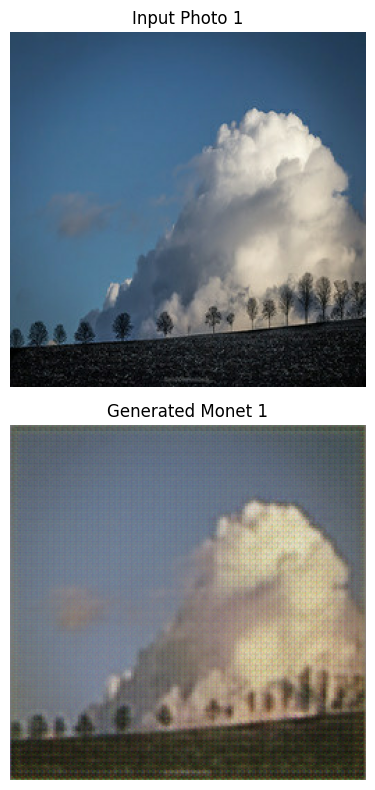

Epoch 2/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 363s 4s/step - cycle_loss: 2.8165 - identity_loss: 0.1654 - monet_disc_loss: 1.4065 - monet_gen_loss: 0.3096 - photo_disc_loss: 1.9946 - photo_gen_loss: -0.0100


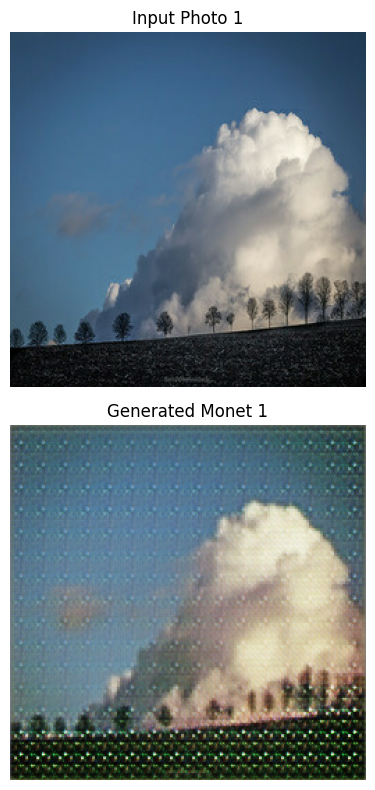

Epoch 3/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 2.2511 - identity_loss: 0.1516 - monet_disc_loss: 1.2785 - monet_gen_loss: 0.3957 - photo_disc_loss: 1.9874 - photo_gen_loss: -0.0126


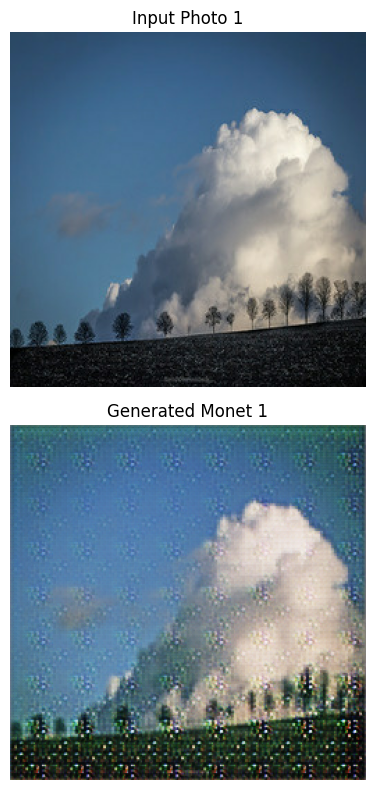

Epoch 4/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 362s 4s/step - cycle_loss: 2.0501 - identity_loss: 0.1470 - monet_disc_loss: 1.3383 - monet_gen_loss: 0.4354 - photo_disc_loss: 1.9811 - photo_gen_loss: -0.0142


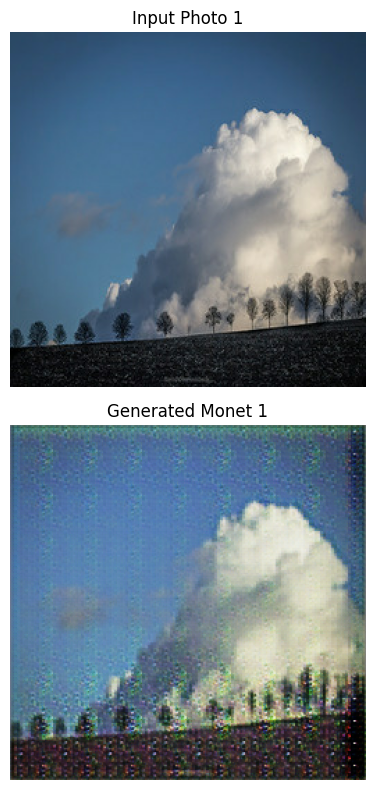

Epoch 5/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.9634 - identity_loss: 0.1591 - monet_disc_loss: 1.4690 - monet_gen_loss: 0.3439 - photo_disc_loss: 1.9712 - photo_gen_loss: -0.0128


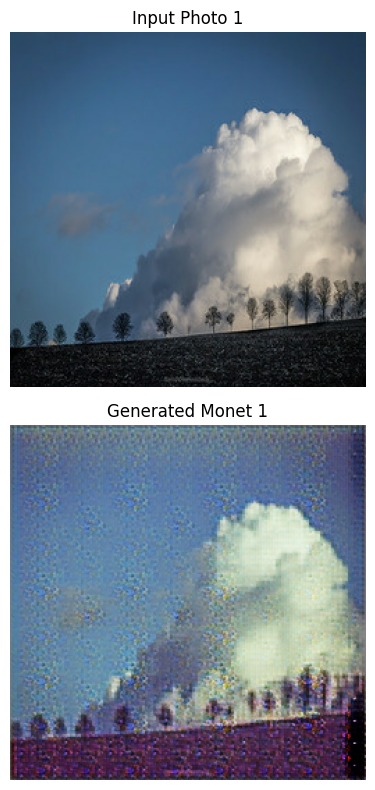

FID after epoch 5: 17.16
Checkpoint saved at epoch 5
Epoch 6/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 362s 4s/step - cycle_loss: 1.9137 - identity_loss: 0.1618 - monet_disc_loss: 1.6739 - monet_gen_loss: 0.1885 - photo_disc_loss: 1.9649 - photo_gen_loss: -0.0144


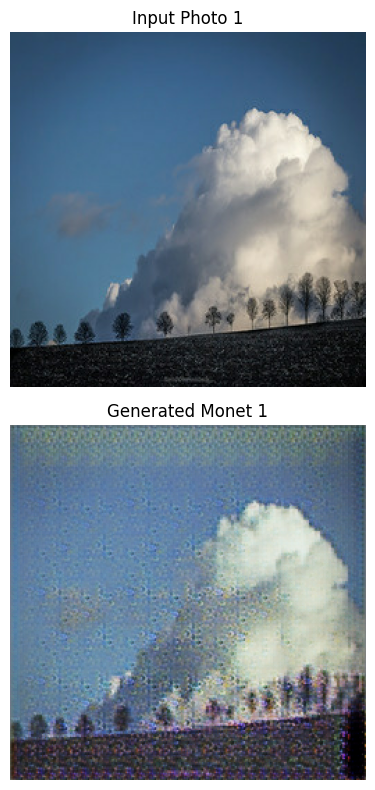

Epoch 7/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 362s 4s/step - cycle_loss: 1.8199 - identity_loss: 0.1601 - monet_disc_loss: 1.6744 - monet_gen_loss: 0.2148 - photo_disc_loss: 1.9593 - photo_gen_loss: -0.0162


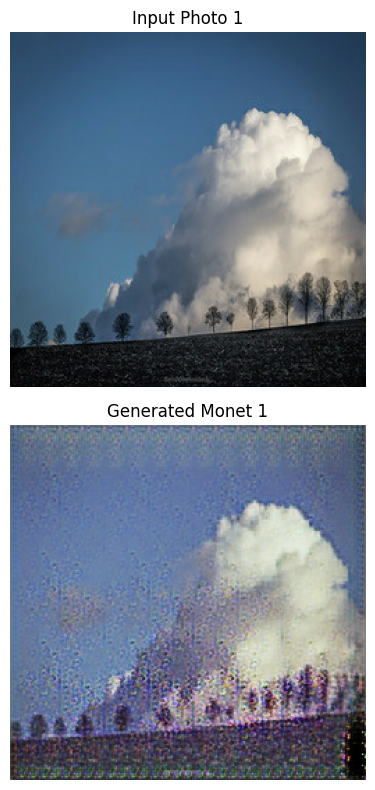

Epoch 8/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.7388 - identity_loss: 0.1533 - monet_disc_loss: 1.6486 - monet_gen_loss: 0.1796 - photo_disc_loss: 1.9550 - photo_gen_loss: -0.0187


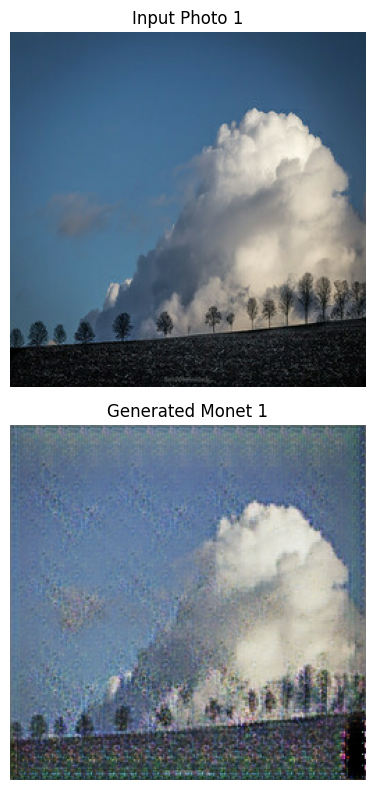

Epoch 9/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.6941 - identity_loss: 0.1497 - monet_disc_loss: 1.6251 - monet_gen_loss: 0.2011 - photo_disc_loss: 1.9612 - photo_gen_loss: -0.0290


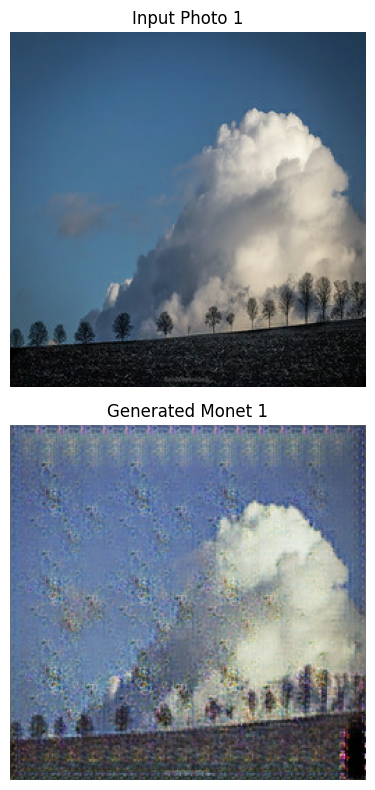

Epoch 10/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.6531 - identity_loss: 0.1464 - monet_disc_loss: 1.6354 - monet_gen_loss: 0.2096 - photo_disc_loss: 1.9521 - photo_gen_loss: -0.0257


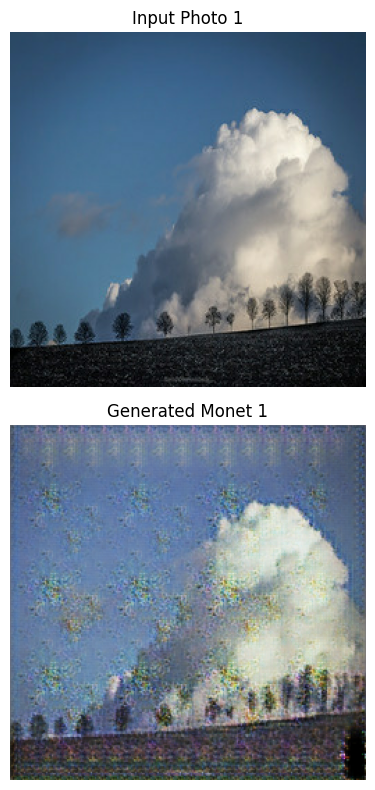

FID after epoch 10: 15.13
Checkpoint saved at epoch 10
Epoch 11/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 362s 4s/step - cycle_loss: 1.6058 - identity_loss: 0.1434 - monet_disc_loss: 1.6675 - monet_gen_loss: 0.1847 - photo_disc_loss: 1.9460 - photo_gen_loss: -0.0262


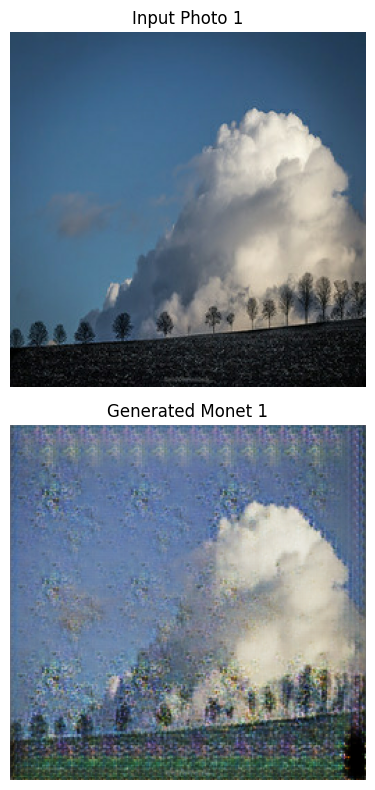

Epoch 12/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 362s 4s/step - cycle_loss: 1.5841 - identity_loss: 0.1418 - monet_disc_loss: 1.6673 - monet_gen_loss: 0.1930 - photo_disc_loss: 1.9434 - photo_gen_loss: -0.0300


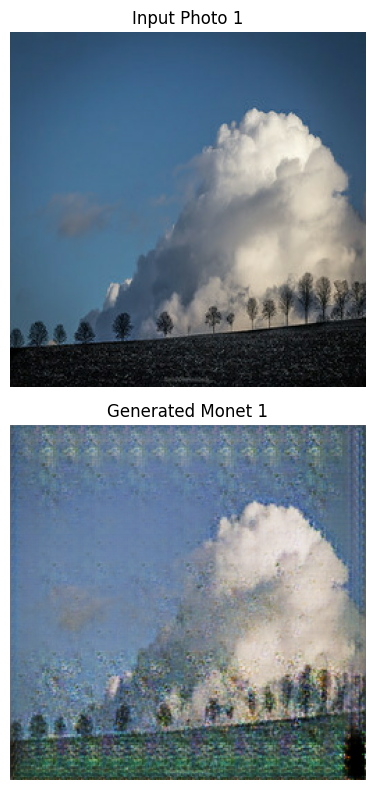

Epoch 13/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.5614 - identity_loss: 0.1389 - monet_disc_loss: 1.7489 - monet_gen_loss: 0.1766 - photo_disc_loss: 1.9414 - photo_gen_loss: -0.0344


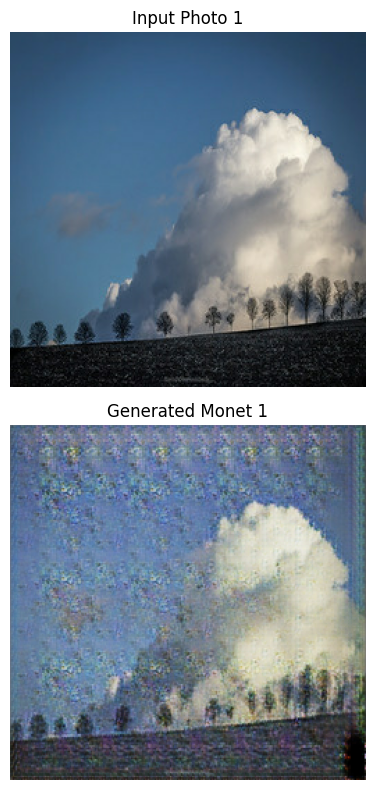

Epoch 14/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.5305 - identity_loss: 0.1382 - monet_disc_loss: 1.7154 - monet_gen_loss: 0.1449 - photo_disc_loss: 1.9379 - photo_gen_loss: -0.0369


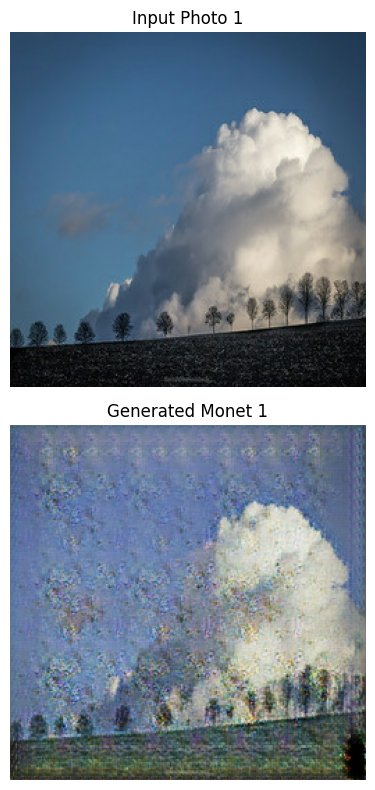

Epoch 15/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.5126 - identity_loss: 0.1361 - monet_disc_loss: 1.7408 - monet_gen_loss: 0.1503 - photo_disc_loss: 1.9364 - photo_gen_loss: -0.0406


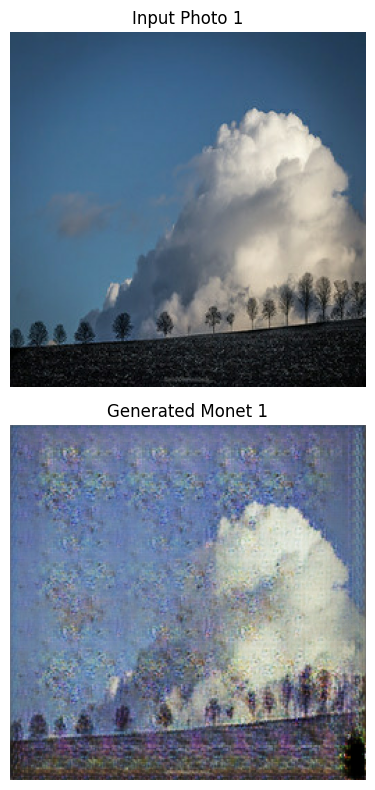

FID after epoch 15: 12.98
Checkpoint saved at epoch 15
Epoch 16/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 363s 4s/step - cycle_loss: 1.4800 - identity_loss: 0.1326 - monet_disc_loss: 1.8180 - monet_gen_loss: 0.1448 - photo_disc_loss: 1.9374 - photo_gen_loss: -0.0464


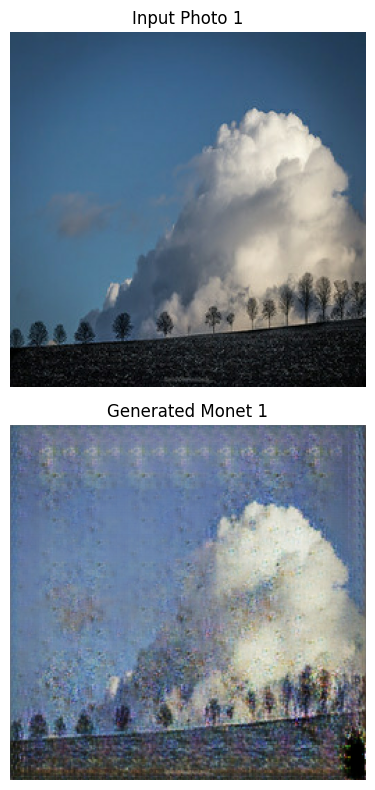

Epoch 17/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.4555 - identity_loss: 0.1315 - monet_disc_loss: 1.7172 - monet_gen_loss: 0.1503 - photo_disc_loss: 1.9402 - photo_gen_loss: -0.0540


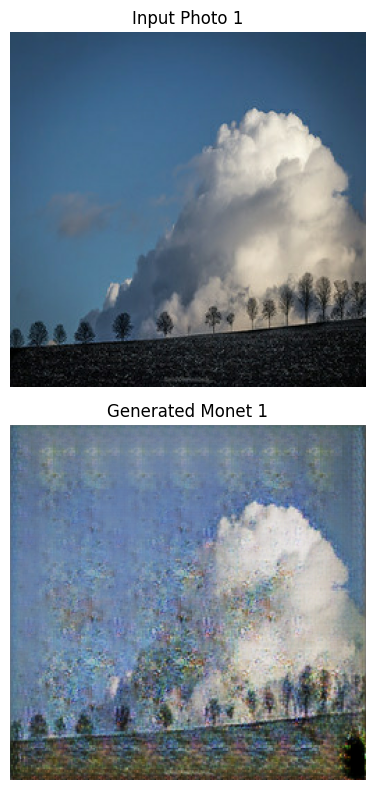

Epoch 18/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.4259 - identity_loss: 0.1289 - monet_disc_loss: 1.7305 - monet_gen_loss: 0.1669 - photo_disc_loss: 1.9434 - photo_gen_loss: -0.0595


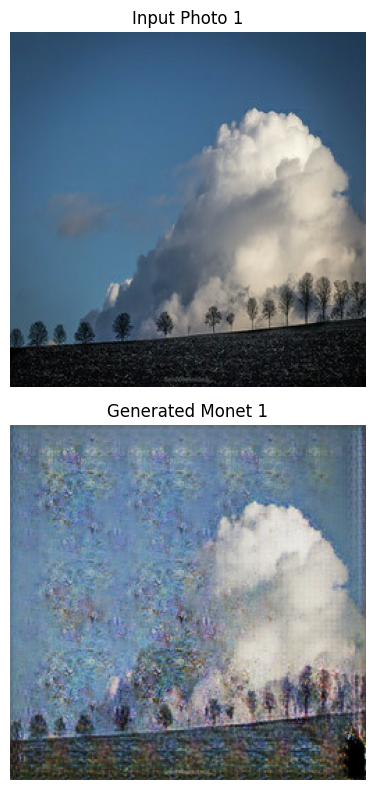

Epoch 19/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.3917 - identity_loss: 0.1286 - monet_disc_loss: 1.7205 - monet_gen_loss: 0.1759 - photo_disc_loss: 1.9323 - photo_gen_loss: -0.0613


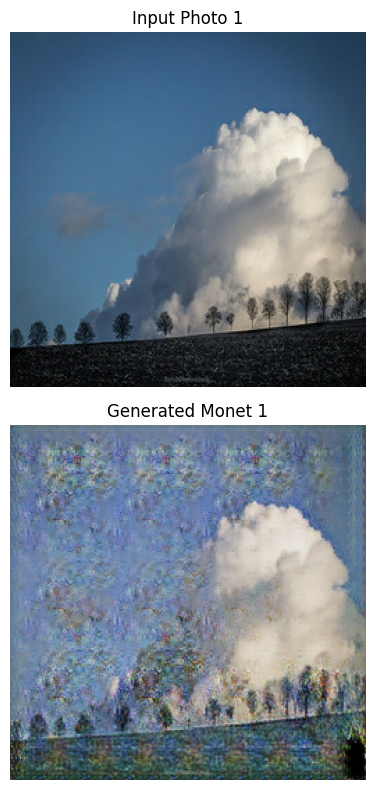

FID after epoch 20: 12.36
Checkpoint saved at epoch 20
Epoch 21/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 362s 4s/step - cycle_loss: 1.3592 - identity_loss: 0.1218 - monet_disc_loss: 1.7097 - monet_gen_loss: 0.1831 - photo_disc_loss: 1.9325 - photo_gen_loss: -0.0646


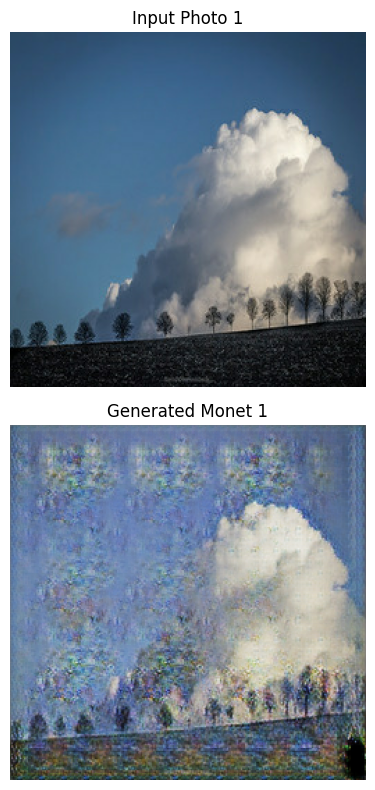

Epoch 22/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.3431 - identity_loss: 0.1256 - monet_disc_loss: 1.7243 - monet_gen_loss: 0.1893 - photo_disc_loss: 1.9290 - photo_gen_loss: -0.0668


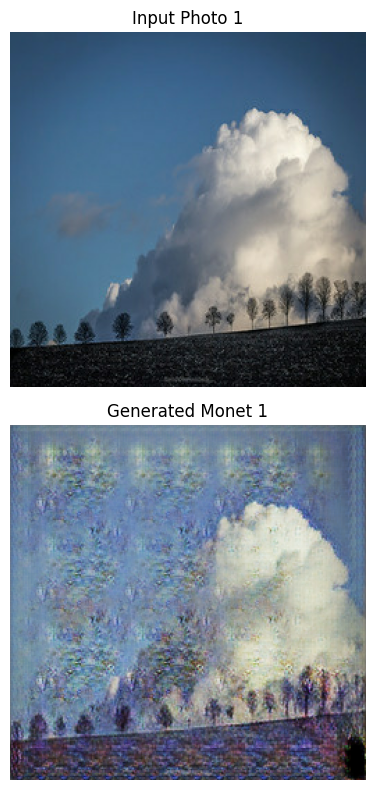

Epoch 23/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.3224 - identity_loss: 0.1249 - monet_disc_loss: 1.7426 - monet_gen_loss: 0.1849 - photo_disc_loss: 1.9264 - photo_gen_loss: -0.0689


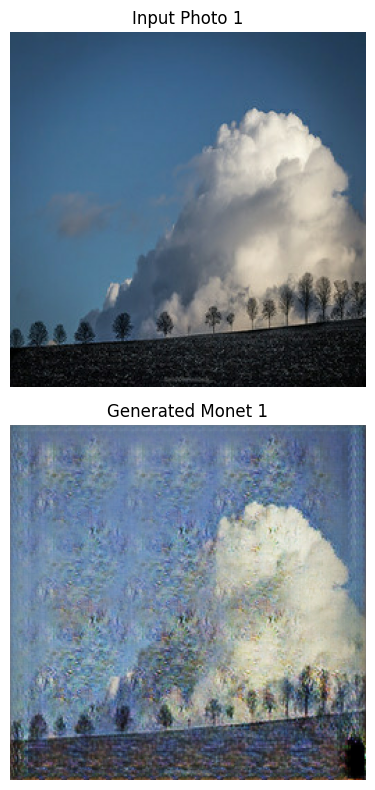

Epoch 24/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 362s 4s/step - cycle_loss: 1.3032 - identity_loss: 0.1215 - monet_disc_loss: 1.6800 - monet_gen_loss: 0.2326 - photo_disc_loss: 1.9203 - photo_gen_loss: -0.0684


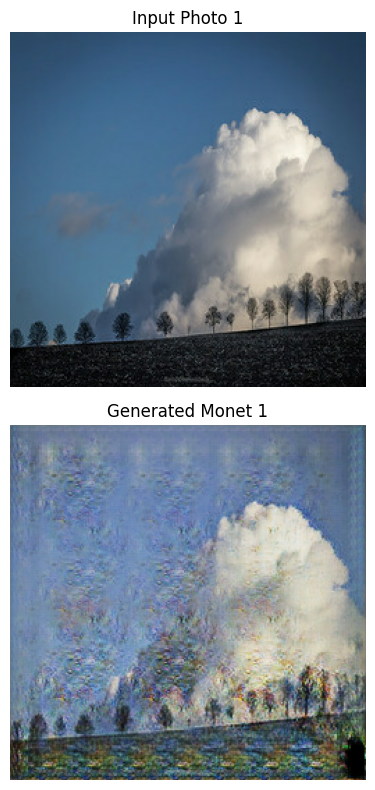

Epoch 25/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.3328 - identity_loss: 0.1275 - monet_disc_loss: 1.7118 - monet_gen_loss: 0.2225 - photo_disc_loss: 1.9167 - photo_gen_loss: -0.0681


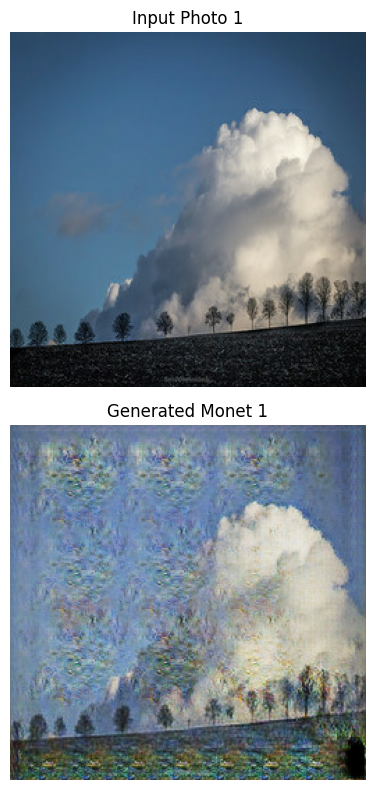

FID after epoch 25: 12.52
Checkpoint saved at epoch 25
Epoch 26/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 364s 4s/step - cycle_loss: 1.2930 - identity_loss: 0.1223 - monet_disc_loss: 1.7014 - monet_gen_loss: 0.2219 - photo_disc_loss: 1.9198 - photo_gen_loss: -0.0738


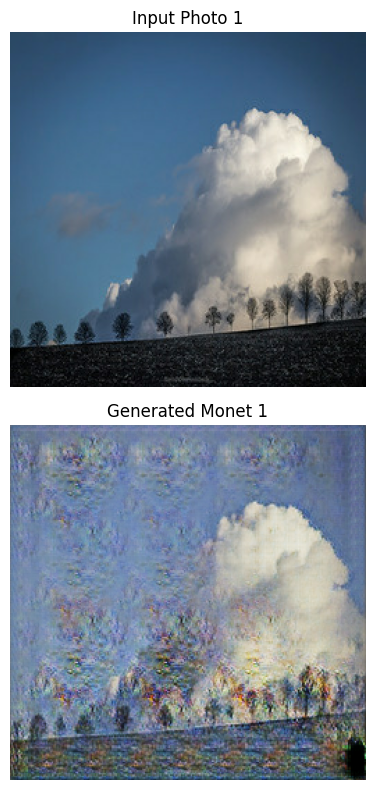

Epoch 27/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.2724 - identity_loss: 0.1181 - monet_disc_loss: 1.6575 - monet_gen_loss: 0.2401 - photo_disc_loss: 1.9180 - photo_gen_loss: -0.0747


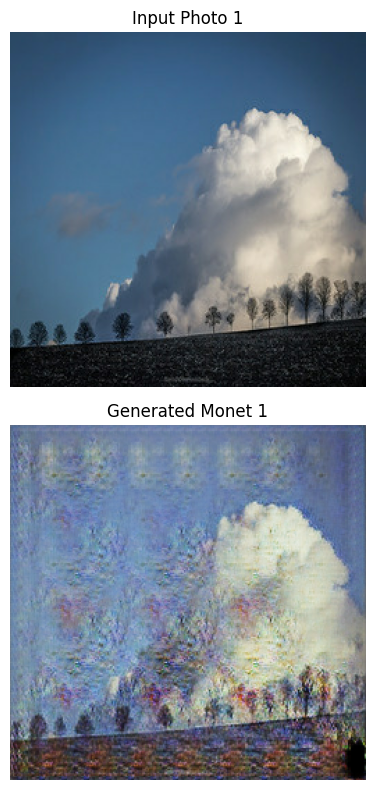

Epoch 28/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.2608 - identity_loss: 0.1175 - monet_disc_loss: 1.7035 - monet_gen_loss: 0.2209 - photo_disc_loss: 1.9196 - photo_gen_loss: -0.0771


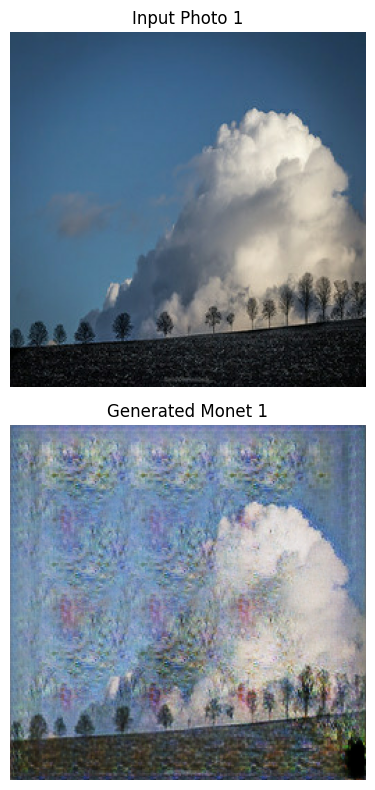

Epoch 29/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.2520 - identity_loss: 0.1161 - monet_disc_loss: 1.7120 - monet_gen_loss: 0.1996 - photo_disc_loss: 1.9211 - photo_gen_loss: -0.0794


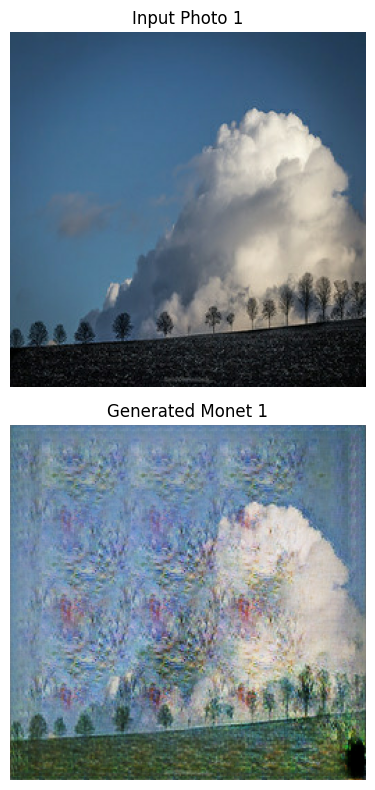

Epoch 30/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.2319 - identity_loss: 0.1133 - monet_disc_loss: 1.7054 - monet_gen_loss: 0.2105 - photo_disc_loss: 1.9203 - photo_gen_loss: -0.0781


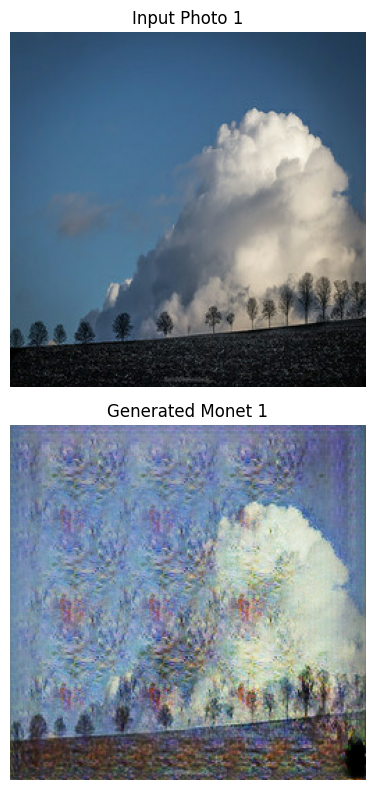

FID after epoch 30: 12.67
Checkpoint saved at epoch 30
Epoch 31/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 364s 4s/step - cycle_loss: 1.2290 - identity_loss: 0.1125 - monet_disc_loss: 1.7255 - monet_gen_loss: 0.1806 - photo_disc_loss: 1.9172 - photo_gen_loss: -0.0769


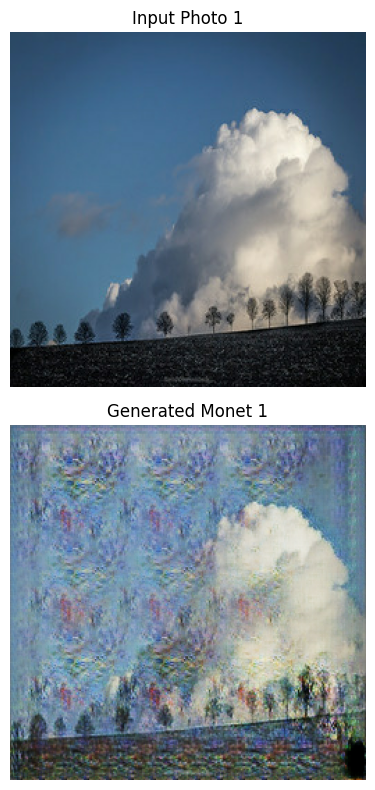

Epoch 32/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.1966 - identity_loss: 0.1109 - monet_disc_loss: 1.7023 - monet_gen_loss: 0.1895 - photo_disc_loss: 1.9304 - photo_gen_loss: -0.0852


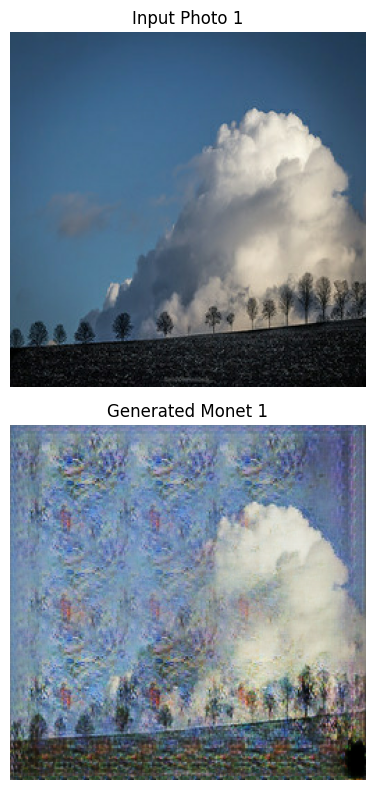

Epoch 33/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.2189 - identity_loss: 0.1096 - monet_disc_loss: 1.7098 - monet_gen_loss: 0.1852 - photo_disc_loss: 1.9324 - photo_gen_loss: -0.0857


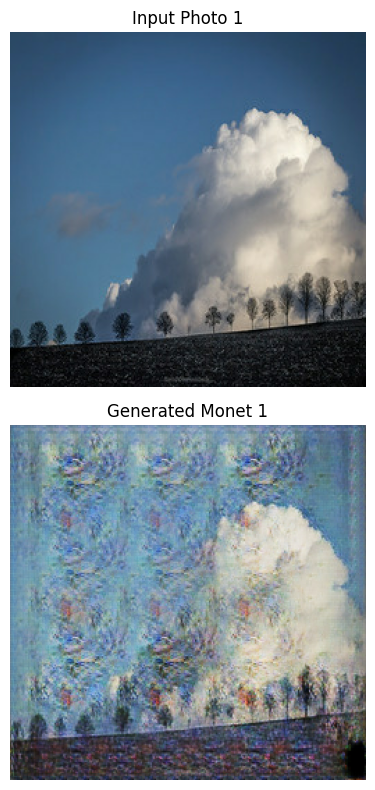

Epoch 34/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.1946 - identity_loss: 0.1096 - monet_disc_loss: 1.7138 - monet_gen_loss: 0.1919 - photo_disc_loss: 1.9471 - photo_gen_loss: -0.0931


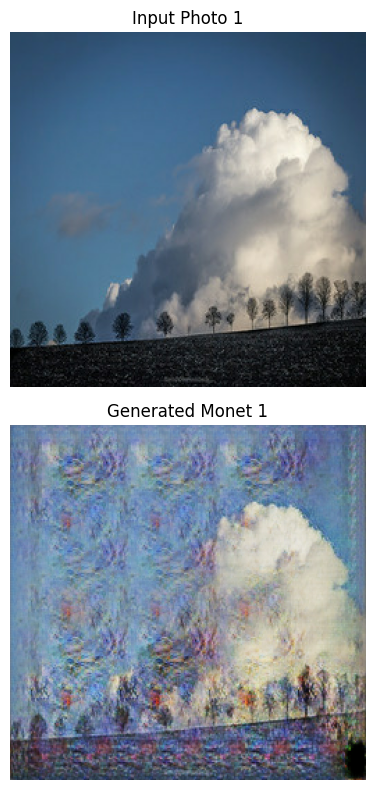

Epoch 35/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.1918 - identity_loss: 0.1109 - monet_disc_loss: 1.7436 - monet_gen_loss: 0.1808 - photo_disc_loss: 1.9479 - photo_gen_loss: -0.0912


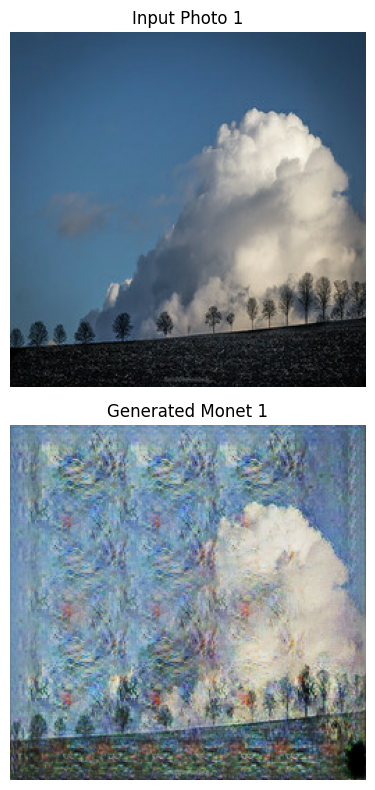

FID after epoch 35: 12.59
Checkpoint saved at epoch 35
Epoch 36/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 364s 4s/step - cycle_loss: 1.2028 - identity_loss: 0.1095 - monet_disc_loss: 1.7474 - monet_gen_loss: 0.1785 - photo_disc_loss: 1.9480 - photo_gen_loss: -0.0900


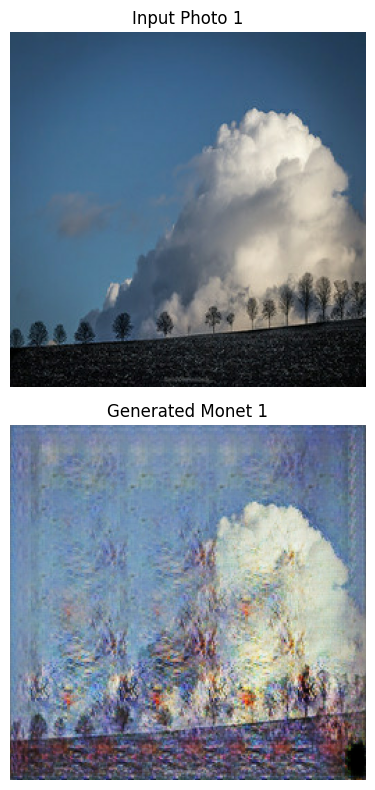

Epoch 37/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.1636 - identity_loss: 0.1092 - monet_disc_loss: 1.7314 - monet_gen_loss: 0.1651 - photo_disc_loss: 1.9477 - photo_gen_loss: -0.0885


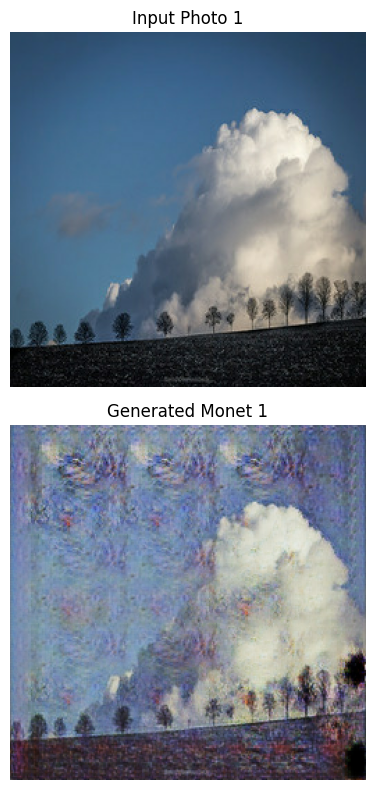

Epoch 38/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.1536 - identity_loss: 0.1116 - monet_disc_loss: 1.6883 - monet_gen_loss: 0.2230 - photo_disc_loss: 1.9451 - photo_gen_loss: -0.0851


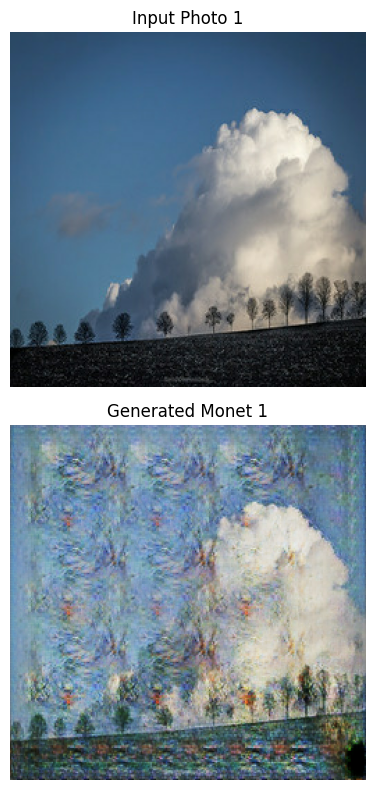

Epoch 39/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.1282 - identity_loss: 0.1056 - monet_disc_loss: 1.7159 - monet_gen_loss: 0.1914 - photo_disc_loss: 1.9489 - photo_gen_loss: -0.0873


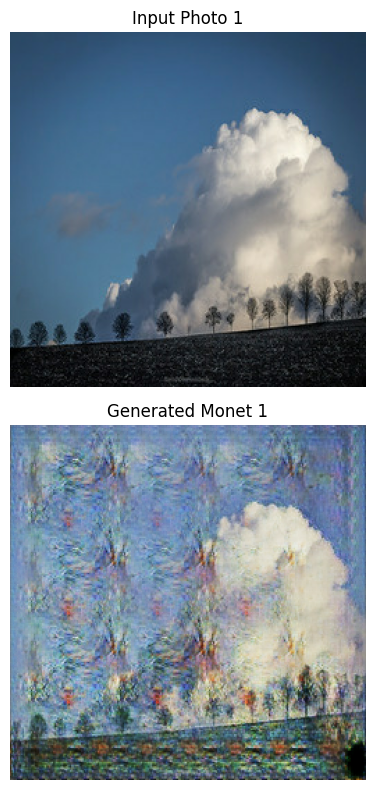

Epoch 40/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.1262 - identity_loss: 0.1063 - monet_disc_loss: 1.6967 - monet_gen_loss: 0.2031 - photo_disc_loss: 1.9395 - photo_gen_loss: -0.0791


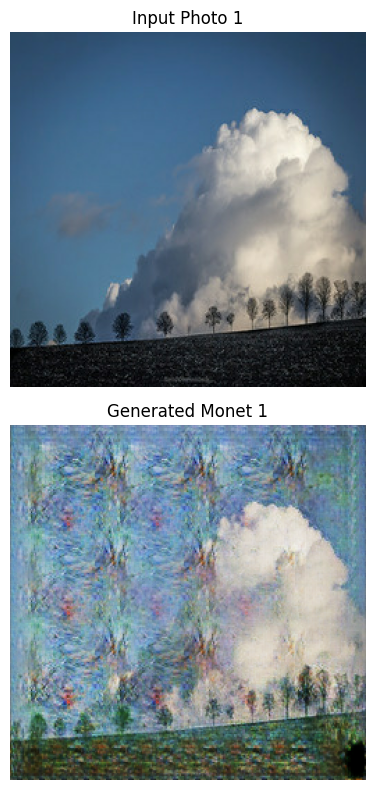

FID after epoch 40: 12.29
Checkpoint saved at epoch 40
Epoch 41/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 363s 4s/step - cycle_loss: 1.1218 - identity_loss: 0.1075 - monet_disc_loss: 1.7120 - monet_gen_loss: 0.1892 - photo_disc_loss: 1.9409 - photo_gen_loss: -0.0807


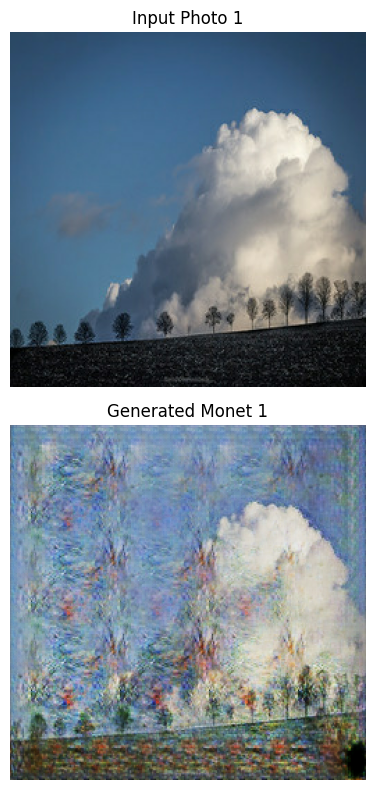

Epoch 42/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.1020 - identity_loss: 0.1040 - monet_disc_loss: 1.7107 - monet_gen_loss: 0.2160 - photo_disc_loss: 1.9377 - photo_gen_loss: -0.0784


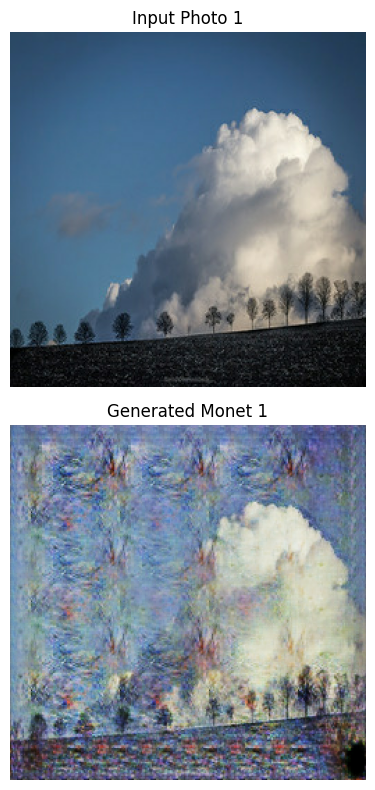

Epoch 43/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.0971 - identity_loss: 0.1043 - monet_disc_loss: 1.7155 - monet_gen_loss: 0.1950 - photo_disc_loss: 1.9343 - photo_gen_loss: -0.0764


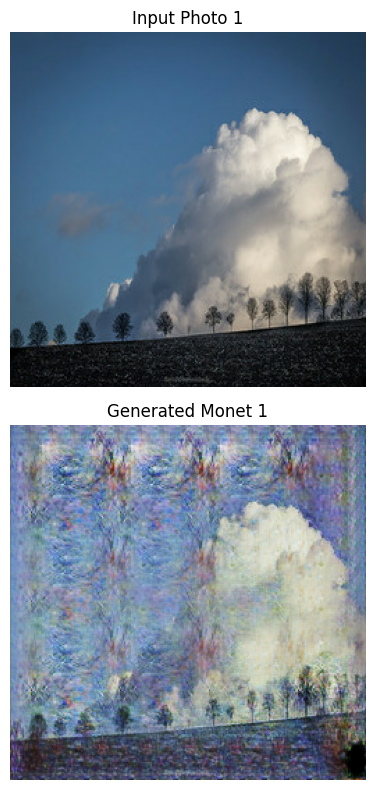

Epoch 44/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.0908 - identity_loss: 0.1045 - monet_disc_loss: 1.7339 - monet_gen_loss: 0.1781 - photo_disc_loss: 1.9357 - photo_gen_loss: -0.0779


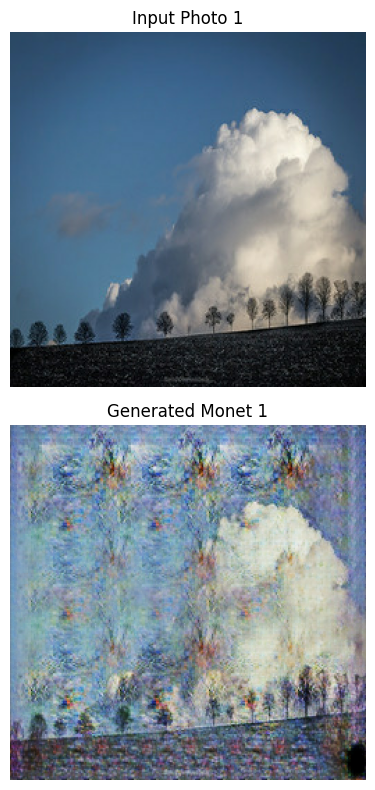

Epoch 45/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 361s 4s/step - cycle_loss: 1.0862 - identity_loss: 0.1052 - monet_disc_loss: 1.7257 - monet_gen_loss: 0.1801 - photo_disc_loss: 1.9308 - photo_gen_loss: -0.0755


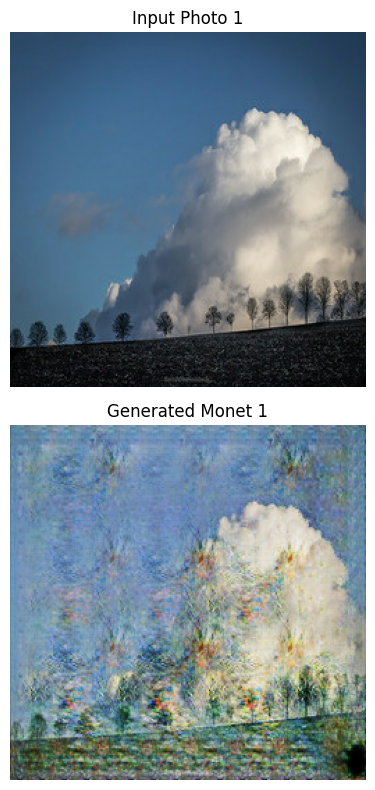

FID after epoch 45: 11.90
Checkpoint saved at epoch 45
Epoch 46/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 364s 4s/step - cycle_loss: 1.0747 - identity_loss: 0.1029 - monet_disc_loss: 1.7178 - monet_gen_loss: 0.1925 - photo_disc_loss: 1.9320 - photo_gen_loss: -0.0762


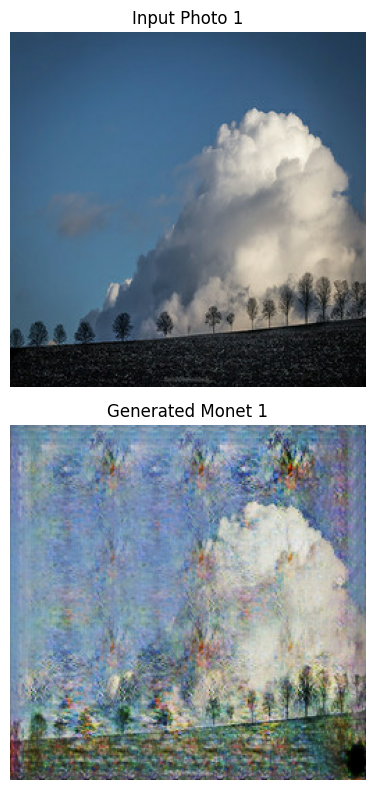

Epoch 47/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.0697 - identity_loss: 0.0998 - monet_disc_loss: 1.7859 - monet_gen_loss: 0.1898 - photo_disc_loss: 1.9319 - photo_gen_loss: -0.0756


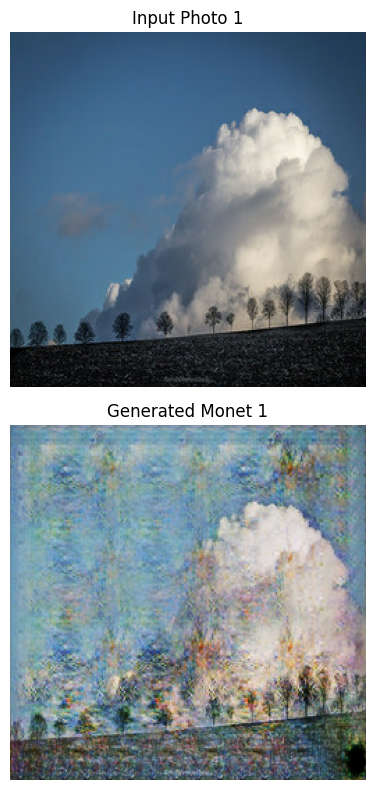

Epoch 48/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.0613 - identity_loss: 0.0999 - monet_disc_loss: 1.7937 - monet_gen_loss: 0.1675 - photo_disc_loss: 1.9333 - photo_gen_loss: -0.0763


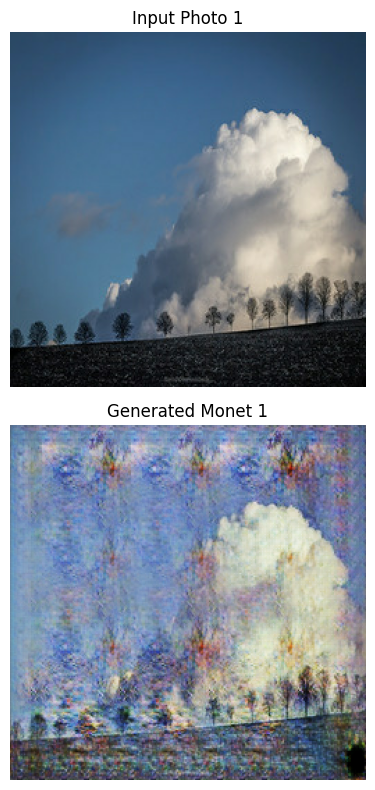

Epoch 49/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.0494 - identity_loss: 0.1005 - monet_disc_loss: 1.7540 - monet_gen_loss: 0.1872 - photo_disc_loss: 1.9303 - photo_gen_loss: -0.0733


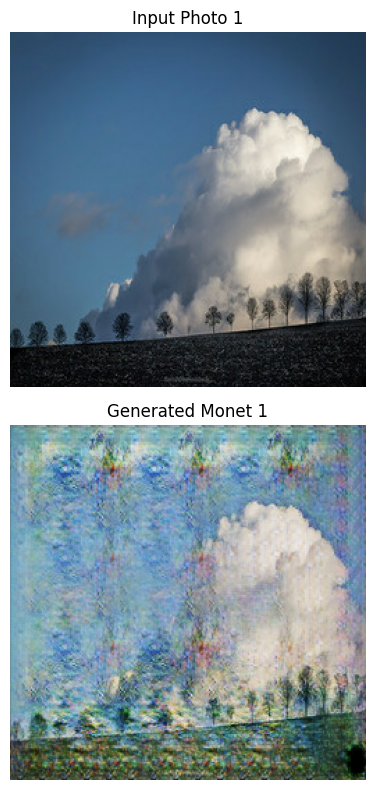

Epoch 50/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 360s 4s/step - cycle_loss: 1.0476 - identity_loss: 0.1034 - monet_disc_loss: 1.7328 - monet_gen_loss: 0.1694 - photo_disc_loss: 1.9280 - photo_gen_loss: -0.0719


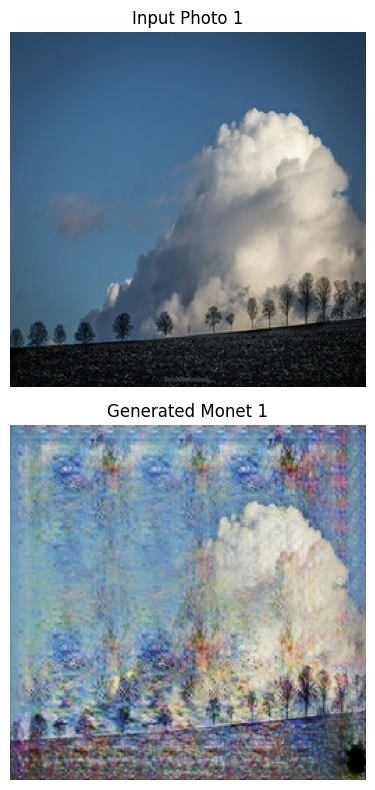

FID after epoch 50: 13.14
Checkpoint saved at epoch 50


In [20]:
# ========================
# 5. Training Loop
# ========================
fids = []  # Track FID scores during training

for epoch in range(1, EPOCHS+1):
    print(f"Epoch {epoch}/{EPOCHS}")
    
    # Train for one epoch
    history = cycle_gan.fit(
        training_dataset,
        epochs=1,
        steps_per_epoch=STEPS_PER_EPOCH,
        callbacks=[viz_callback],  # Use the visualization callback
        verbose=1
    )
    
    # Periodic Evaluation
    if epoch % FID_INTERVAL == 0:
        try:
            # Calculate FID
            fid_score = compute_fid(
                monet_generator,
                inception_model,
                myFID_mu_real,
                myFID_sigma_real,
                fid_photo_ds.take(64)  # Use subset for faster evaluation
            )
            fids.append(fid_score.numpy())
            print(f"FID after epoch {epoch}: {fid_score:.2f}")
            
            # Save checkpoint
            checkpoint_dir = f"./cyclegan_checkpoints/epoch_{epoch}"
            checkpoint = tf.train.Checkpoint(
                monet_generator=monet_generator,
                photo_generator=photo_generator,
                monet_generator_optimizer=monet_generator_optimizer,
                photo_generator_optimizer=photo_generator_optimizer
            )
            checkpoint.save(checkpoint_dir)
            print(f"Checkpoint saved at epoch {epoch}")
        except Exception as e:
            print(f"Error during FID calculation: {e}")
            continue

# Learning rate decay after halfway
if epoch == EPOCHS // 2:
    print("Reducing learning rate by factor of 10")
    # Reduce learning rates
    monet_generator_optimizer.learning_rate = monet_generator_optimizer.learning_rate * 0.1
    photo_generator_optimizer.learning_rate = photo_generator_optimizer.learning_rate * 0.1
    monet_discriminator_optimizer.learning_rate = monet_discriminator_optimizer.learning_rate * 0.1
    photo_discriminator_optimizer.learning_rate = photo_discriminator_optimizer.learning_rate * 0.1

Saving final models...


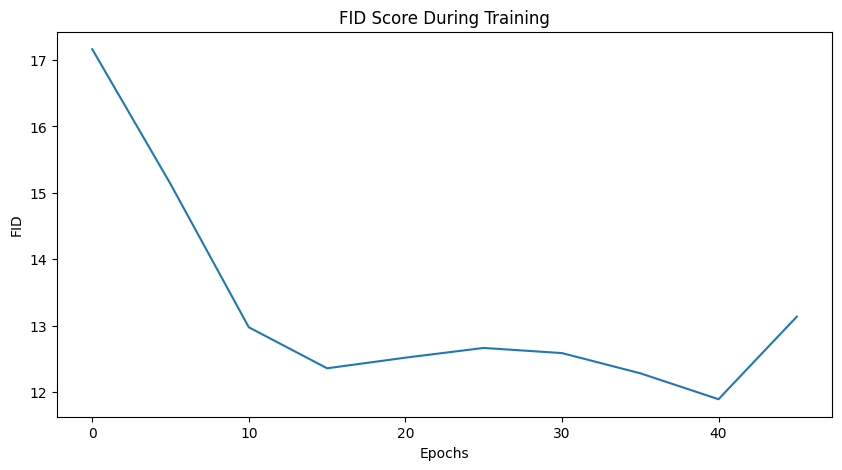

In [21]:
# ========================
# 6. Final Save
# ========================
print("Saving final models...")
monet_generator.save("monet_generator_final.h5")
photo_generator.save("photo_generator_final.h5")

# Plot FID progression
if len(fids) > 0:
    plt.figure(figsize=(10, 5))
    plt.plot(np.arange(0, EPOCHS, FID_INTERVAL)[0:len(fids)], fids)
    plt.title("FID Score During Training")
    plt.xlabel("Epochs")
    plt.ylabel("FID")
    plt.savefig("fid_progress.png")
    plt.show()

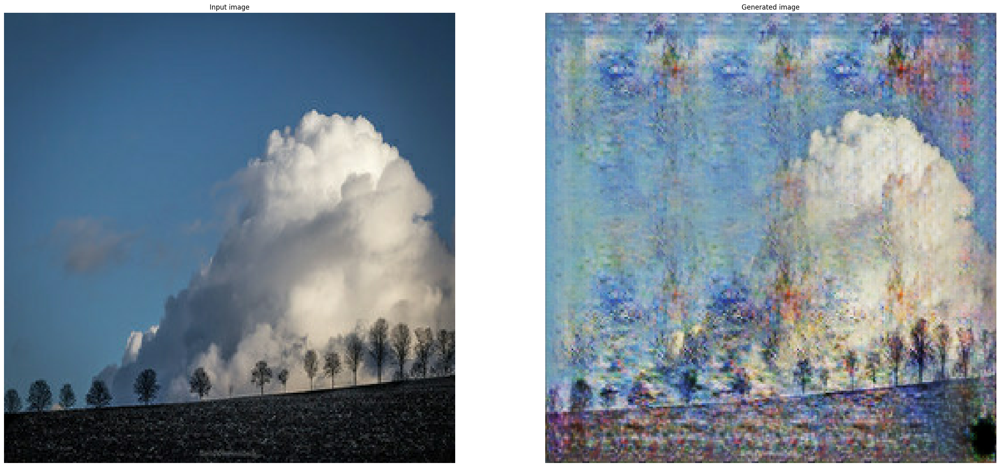

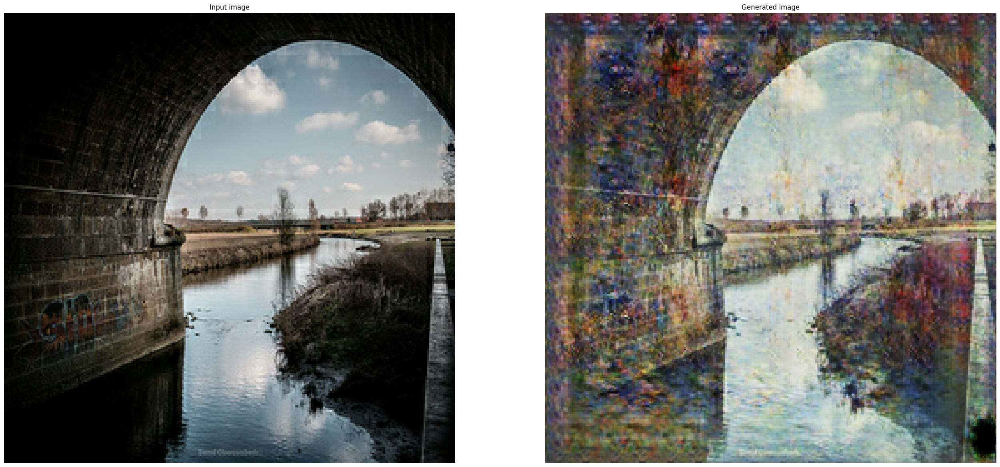

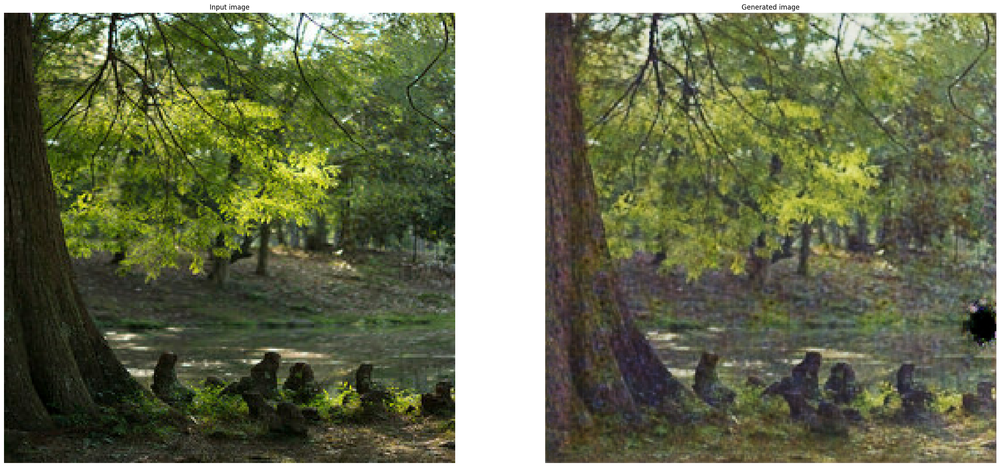

In [22]:
ds_iter = iter(photo_ds)
for n_sample in range(3):
        example_sample = next(ds_iter)
        generated_sample = monet_generator(example_sample)
        
        f = plt.figure(figsize=(32, 32))
        
        plt.subplot(121)
        plt.title('Input image')
        plt.imshow(example_sample[0] * 0.5 + 0.5)
        plt.axis('off')
        
        plt.subplot(122)
        plt.title('Generated image')
        plt.imshow(generated_sample[0] * 0.5 + 0.5)
        plt.axis('off')
        plt.show()

In [23]:
# Create a temporary directory if it doesn't exist
os.makedirs("../tmp", exist_ok=True)
zip_path = "../tmp/images.zip"

# Create a function to generate and process images in batches
def generate_monet_images(photo_dataset, generator_model, batch_size=32):
    """
    Generates Monet-style images from a photo dataset and saves them directly to a zip file.
    
    Args:
        photo_dataset: TensorFlow dataset of photos
        generator_model: Trained Monet generator model
        batch_size: Number of images to process at once
    """
    start_time = time.time()
    
    # Check if dataset is already batched
    # We won't re-batch it if it's already batched
    dataset = photo_dataset
    
    # Create zip file
    with zipfile.ZipFile(zip_path, 'w', compression=zipfile.ZIP_DEFLATED) as zipf:
        image_count = 0
        
        # Add a simple progress bar
        for batch in tqdm(dataset):
            # Handle potential batching issues by checking the tensor rank
            tensor_rank = len(batch.shape)
            
            # If tensor has too many dimensions, we need to reshape
            if (tensor_rank > 4):  # Should be [batch, height, width, channels]
                print(f"Warning: Input tensor has shape {batch.shape}, reshaping...")
                # Assuming the first two dimensions are batch dimensions
                batch_size = batch.shape[0] * batch.shape[1]
                batch = tf.reshape(batch, [batch_size, *batch.shape[2:]])
                print(f"Reshaped to {batch.shape}")
            
            # Generate Monet-style images
            generated_images = generator_model(batch, training=False)
            
            # Convert from [-1, 1] to [0, 255] uint8
            generated_images = ((generated_images.numpy() * 0.5 + 0.5) * 255).astype(np.uint8)
            
            # Process each image in the batch
            for img in generated_images:
                # Convert to PIL Image
                pil_img = Image.fromarray(img)
                
                # Create in-memory buffer
                img_buffer = io.BytesIO()
                
                # Save as JPEG to buffer
                pil_img.save(img_buffer, format='JPEG', quality=95)
                
                # Reset buffer position
                img_buffer.seek(0)
                
                # Add to zip file with sequential naming
                img_name = f"{image_count + 1}.jpg"
                zipf.writestr(img_name, img_buffer.getvalue())
                
                image_count += 1
                
                # Optional: Add status update every 1000 images
                if image_count % 1000 == 0:
                    elapsed = time.time() - start_time
                    print(f"Generated {image_count} images in {elapsed:.2f} seconds")
    
    elapsed = time.time() - start_time
    print(f"Generation complete! Created {image_count} images in {elapsed:.2f} seconds")
    print(f"Zip file saved to: {zip_path}")
    
    # Optional: Calculate zip file size
    zip_size_mb = os.path.getsize(zip_path) / (1024 * 1024)
    print(f"Zip file size: {zip_size_mb:.2f} MB")
    
    return image_count

# Copy zip to final Kaggle output location
def finalize_submission():
    """Copies the zip file to the Kaggle output location"""
    import shutil
    output_path = "images.zip"
    shutil.copy(zip_path, output_path)
    print(f"Submission file copied to: {output_path}")
    
    # Verify contents
    with zipfile.ZipFile(output_path, 'r') as zipf:
        file_count = len(zipf.namelist())
        print(f"Verified zip contains {file_count} images")

# Prepare a proper dataset for generation
# CRITICAL: Don't use load_dataset that already batches the data
# We need to handle the batching carefully here
def prepare_photo_dataset(photo_files, batch_size=32):
    # Load the TFRecord dataset without prior batching
    dataset = tf.data.TFRecordDataset(photo_files)
    
    # Parse the records
    def read_tfrecord(example):
        tfrecord_format = {"image": tf.io.FixedLenFeature([], tf.string)}
        example = tf.io.parse_single_example(example, tfrecord_format)
        image = tf.image.decode_jpeg(example['image'], channels=3)
        image = (tf.cast(image, tf.float32) / 127.5) - 1
        image = tf.reshape(image, [256, 256, 3])
        return image
    
    # Map the parsing function and batch
    dataset = dataset.map(read_tfrecord, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)
    
    return dataset

# 1. Prepare the dataset properly
photo_ds_for_generation = prepare_photo_dataset(PHOTO_TFREC)

# 2. Generate images and create zip
total_images = generate_monet_images(photo_ds_for_generation, monet_generator)

# 3. Finalize submission
finalize_submission()

0it [00:00, ?it/s]

Generated 1000 images in 9.67 seconds
Generated 2000 images in 19.10 seconds
Generated 3000 images in 28.27 seconds
Generated 4000 images in 36.91 seconds
Generated 5000 images in 45.47 seconds
Generated 6000 images in 53.74 seconds
Generated 7000 images in 61.94 seconds
Generation complete! Created 7038 images in 64.32 seconds
Zip file saved to: ../tmp/images.zip
Zip file size: 257.65 MB
Submission file copied to: images.zip
Verified zip contains 7038 images


# Save Model for FastAPI Deployment

This section focuses on properly saving the Monet Generator model in a format that can be easily downloaded from Kaggle and used in a FastAPI application.

In [25]:
# Create a directory to save models for FastAPI
fastapi_model_dir = os.path.abspath("./monet_generator_fastapi")
os.makedirs(fastapi_model_dir, exist_ok=True)
print(f"Model will be saved to: {fastapi_model_dir}")

# 1. Save the model in SavedModel format using export (for newer TF versions)
tf_savedmodel_path = os.path.join(fastapi_model_dir, "saved_model")
try:
    # Try export method first (for newer TF versions)
    monet_generator.export(tf_savedmodel_path)
    print(f"SavedModel exported to: {tf_savedmodel_path}")
except (AttributeError, ValueError) as e:
    # Fallback for older TF versions that don't have export
    print(f"Export failed: {e}")
    print("Trying alternative SavedModel method...")
    try:
        # Create directory first
        os.makedirs(tf_savedmodel_path, exist_ok=True)
        tf.saved_model.save(monet_generator, tf_savedmodel_path)
        print(f"Model saved with tf.saved_model.save() to: {tf_savedmodel_path}")
    except Exception as e2:
        print(f"Alternative SavedModel method failed: {e2}")

# 2. Save the model in H5 format (specify extension and format explicitly)
h5_path = os.path.join(fastapi_model_dir, "monet_generator.h5")
try:
    monet_generator.save(h5_path, save_format='h5')
    print(f"H5 format model saved to: {h5_path}")
except Exception as e:
    print(f"H5 save failed: {e}")
    # Try alternative Keras format
    keras_path = os.path.join(fastapi_model_dir, "monet_generator.keras")
    try:
        monet_generator.save(keras_path)
        print(f"Keras format model saved to: {keras_path}")
    except Exception as e2:
        print(f"Keras save failed: {e2}")

# 3. Save sample input/output for testing
sample_dir = os.path.join(fastapi_model_dir, "samples")
os.makedirs(sample_dir, exist_ok=True)

# Save a few sample images and their Monet-style versions
# Reduced to 5 samples for faster execution
for i, img in enumerate(photo_ds.take(5)):
    # Generate Monet-style image
    generated = monet_generator(img, training=False)[0]
    
    # Convert to numpy arrays in [0, 255] range
    input_img = ((img[0].numpy() * 0.5 + 0.5) * 255).astype(np.uint8)
    output_img = ((generated.numpy() * 0.5 + 0.5) * 255).astype(np.uint8)
    
    # Save with PIL
    Image.fromarray(input_img).save(os.path.join(sample_dir, f"sample_{i}_input.jpg"))
    Image.fromarray(output_img).save(os.path.join(sample_dir, f"sample_{i}_output.jpg"))

print(f"Sample images saved to: {sample_dir}")

# 4. Verify model by loading and testing
try:
    print("Attempting to load and verify the saved model...")
    
    # Try different loading approaches
    loaded_model = None
    
    # Try tf.saved_model.load first
    try:
        loaded_model = tf.saved_model.load(tf_savedmodel_path)
        print("Model loaded with tf.saved_model.load")
        
        # Create a function to run inference with the loaded model
        @tf.function
        def run_model(x):
            if hasattr(loaded_model, '__call__'):
                return loaded_model(x, training=False)
            elif hasattr(loaded_model, 'signatures'):
                # Some SavedModels use signatures
                return loaded_model.signatures['serving_default'](tf.constant(x))
            else:
                print("Model loaded but structure is unexpected")
                return None
    except Exception as e:
        print(f"tf.saved_model.load failed: {e}")
        
        # Try keras.models.load_model as fallback
        try:
            # Try H5 file
            if os.path.exists(h5_path):
                loaded_model = tf.keras.models.load_model(h5_path)
                print("Model loaded from H5 file")
            # Or try Keras format
            elif os.path.exists(os.path.join(fastapi_model_dir, "monet_generator.keras")):
                loaded_model = tf.keras.models.load_model(
                    os.path.join(fastapi_model_dir, "monet_generator.keras")
                )
                print("Model loaded from Keras format file")
            
            # Use standard model call for keras models
            run_model = lambda x: loaded_model(x, training=False)
        except Exception as e2:
            print(f"All loading methods failed: {e2}")
    
    # If we've loaded a model, test it
    if loaded_model is not None:
        # Test with a sample input
        test_input = next(iter(photo_ds))
        original_output = monet_generator(test_input, training=False)[0]
        
        # Use our run_model function
        loaded_output = run_model(test_input)[0]
        
        # Compare outputs (should be similar)
        max_diff = tf.reduce_max(tf.abs(original_output - loaded_output))
        print(f"Maximum difference between original and loaded outputs: {max_diff.numpy():.10f}")
        
        if max_diff.numpy() < 1e-5:
            print("✅ Model verification successful!")
        else:
            print("⚠️ Model outputs differ slightly, but may still work")
        
        # Show test images
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        axes[0].imshow(test_input[0] * 0.5 + 0.5)
        axes[0].set_title("Input Photo")
        axes[0].axis("off")
        
        axes[1].imshow(original_output * 0.5 + 0.5)
        axes[1].set_title("Original Model Output")
        axes[1].axis("off")
        
        axes[2].imshow(loaded_output * 0.5 + 0.5)
        axes[2].set_title("Loaded Model Output")
        axes[2].axis("off")
        
        plt.tight_layout()
        plt.show()
    else:
        print("❌ Could not load the model with any method")
        
except Exception as e:
    print(f"Error during model verification: {e}")
    
    # One last attempt - try to save in a format that might work better
    print("\nTrying one last saving approach...")
    try:
        # Try saving with explicit keras format
        keras_path = os.path.join(fastapi_model_dir, "monet_generator.keras")
        monet_generator.save(keras_path)
        print(f"Model saved in .keras format to: {keras_path}")
        
        # Try loading it back
        loaded_model = tf.keras.models.load_model(keras_path)
        print("✅ Successfully loaded the model saved in .keras format")
    except Exception as e:
        print(f"Final attempt failed: {e}")

Model will be saved to: /kaggle/working/monet_generator_fastapi
Saved artifact at '/kaggle/working/monet_generator_fastapi/saved_model'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name='keras_tensor_313')
Output Type:
  TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None)
Captures:
  138385861333200: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138385861332624: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138385861330896: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138385861331664: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138385861331088: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138385861330128: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138385861330320: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138385861335888: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138385861329168: TensorSpec(shape=(), dty

# Create FastAPI Implementation Files

Let's create the necessary files for a FastAPI implementation that will be included with the saved model.

In [26]:
# 1. Create app.py for the FastAPI implementation
fastapi_code = '''from fastapi import FastAPI, File, UploadFile, HTTPException
from fastapi.responses import Response, FileResponse, HTMLResponse
from fastapi.staticfiles import StaticFiles
import tensorflow as tf
import numpy as np
from PIL import Image
import io
import os
import time
import uvicorn

# Create FastAPI app
app = FastAPI(title="Monet Style Transfer API",
              description="Convert photos to Monet-style paintings using CycleGAN",
              version="1.0.0")

# Path configuration
MODEL_PATH = os.environ.get("MODEL_PATH", "saved_model")
SAMPLES_PATH = os.environ.get("SAMPLES_PATH", "samples")

# Mount static files directory if it exists
if os.path.exists(SAMPLES_PATH):
    app.mount("/samples", StaticFiles(directory=SAMPLES_PATH), name="samples")

# Global variable for the model
model = None

# Stats tracking
request_count = 0
processing_times = []

@app.on_event("startup")
async def load_model():
    """Load the TensorFlow model on startup"""
    global model
    try:
        print(f"Loading model from {MODEL_PATH}...")
        model = tf.keras.models.load_model(MODEL_PATH)
        # Warmup inference
        dummy_input = tf.random.normal([1, 256, 256, 3])
        _ = model(dummy_input, training=False)
        print("Model loaded successfully!")
    except Exception as e:
        print(f"Error loading model: {e}")
        # Model will remain None, and API will return error when used

def preprocess_image(image):
    """Preprocess image for the model"""
    # Resize to model's expected input
    image = image.resize((256, 256))
    # Convert to numpy array and normalize to [-1, 1]
    img_array = np.array(image)
    img_array = (img_array / 127.5) - 1
    # Add batch dimension
    return np.expand_dims(img_array, axis=0)

def postprocess_image(img_array):
    """Convert model output back to displayable image"""
    # Denormalize from [-1, 1] to [0, 255]
    img_array = (img_array * 0.5 + 0.5) * 255
    img_array = np.clip(img_array, 0, 255).astype(np.uint8)
    # Convert to PIL Image
    return Image.fromarray(img_array)

@app.get("/", response_class=HTMLResponse)
async def root():
    """Serve a simple HTML interface"""
    html_content = """<!DOCTYPE html>
<html>
<head>
    <title>Monet Style Transfer API</title>
    <style>
        body { font-family: Arial, sans-serif; line-height: 1.6; padding: 20px; max-width: 800px; margin: 0 auto; }
        h1 { color: #2c3e50; }
        form { margin: 20px 0; padding: 20px; border: 1px solid #ddd; border-radius: 5px; }
        input, button { margin: 10px 0; }
        .sample { margin: 20px 0; }
        .sample-images { display: flex; margin: 10px 0; }
        .sample-images img { max-width: 300px; margin-right: 10px; border: 1px solid #ddd; }
        code { background: #f4f4f4; padding: 2px 5px; border-radius: 3px; }
    </style>
</head>
<body>
    <h1>Monet Style Transfer API</h1>
    <p>This API converts regular photos into Monet-style paintings using a trained CycleGAN model.</p>
    
    <h2>Try it out</h1>
    <form action="/generate/" method="post" enctype="multipart/form-data" target="_blank">
        <p>Upload a photo to convert to Monet style:</p>
        <input type="file" name="file" accept="image/*" required>
        <br>
        <button type="submit">Generate Monet Style</button>
    </form>
    
    <div class="sample">
        <h2>Sample Transformations</h2>
        <div class="sample-images">
            <div>
                <p>Sample 1 (Input)</p>
                <img src="/samples/sample_0_input.jpg" alt="Sample Input 1">
            </div>
            <div>
                <p>Sample 1 (Output)</p>
                <img src="/samples/sample_0_output.jpg" alt="Sample Output 1">
            </div>
        </div>
    </div>
    
    <h2>API Usage</h2>
    <p>Use the following endpoint to generate Monet-style images:</p>
    <code>POST /generate/</code>
    
    <p>Example with curl:</p>
    <code>curl -X POST "http://localhost:8000/generate/" -H "accept: image/jpeg" -H "Content-Type: multipart/form-data" -F "file=@your_photo.jpg" --output monet_style.jpg</code>
    
    <p>The API will return the Monet-style image directly. For programmatic usage, see the <a href="/docs">API documentation</a>.</p>
</body>
</html>
    """
    return html_content

@app.get("/stats")
async def get_stats():
    """Return statistics about API usage"""
    global request_count, processing_times
    
    avg_time = sum(processing_times) / max(len(processing_times), 1)
    max_time = max(processing_times) if processing_times else 0
    min_time = min(processing_times) if processing_times else 0
    
    return {
        "total_requests": request_count,
        "average_processing_time_ms": round(avg_time * 1000, 2),
        "max_processing_time_ms": round(max_time * 1000, 2),
        "min_processing_time_ms": round(min_time * 1000, 2),
        "model_path": MODEL_PATH,
        "model_loaded": model is not None
    }

@app.post("/generate/")
async def generate_monet(file: UploadFile = File(...)):
    """Generate a Monet-style image from an uploaded photo"""
    global request_count, processing_times
    request_count += 1
    
    # Check if model is loaded
    if model is None:
        raise HTTPException(status_code=500, detail="Model not loaded. Please try again later.")
    
    start_time = time.time()
    
    try:
        # Read and validate image
        content = await file.read()
        image = Image.open(io.BytesIO(content))
        
        # Ensure image is in RGB mode
        if image.mode != "RGB":
            image = image.convert("RGB")
        
        # Preprocess image
        input_tensor = preprocess_image(image)
        
        # Generate Monet-style image
        output_tensor = model(input_tensor, training=False)[0].numpy()
        
        # Postprocess and prepare response
        output_image = postprocess_image(output_tensor)
        img_byte_arr = io.BytesIO()
        output_image.save(img_byte_arr, format="JPEG", quality=95)
        img_byte_arr.seek(0)
        
        # Record processing time
        elapsed = time.time() - start_time
        processing_times.append(elapsed)
        if len(processing_times) > 100:  # Keep only last 100 times
            processing_times = processing_times[-100:]
        
        return Response(content=img_byte_arr.getvalue(), media_type="image/jpeg")
        
    except Exception as e:
        raise HTTPException(status_code=400, detail=f"Error processing image: {str(e)}")

@app.get("/sample/{sample_id}")
async def get_sample(sample_id: int):
    """Return a sample transformation pair"""
    input_path = os.path.join(SAMPLES_PATH, f"sample_{sample_id}_input.jpg")
    output_path = os.path.join(SAMPLES_PATH, f"sample_{sample_id}_output.jpg")
    
    if not os.path.exists(input_path) or not os.path.exists(output_path):
        raise HTTPException(status_code=404, detail=f"Sample {sample_id} not found")
    
    # Return HTML that displays both images
    html_content = f"""
    <!DOCTYPE html>
    <html>
    <head>
        <title>Sample {sample_id}</title>
        <style>
            body {{ display: flex; flex-direction: column; align-items: center; }}
            .image-container {{ display: flex; margin: 20px; }}
            .image-box {{ margin: 10px; text-align: center; }}
            img {{ max-width: 400px; max-height: 400px; }}
        </style>
    </head>
    <body>
        <h1>Sample {sample_id}</h1>
        <div class="image-container">
            <div class="image-box">
                <h2>Original Photo</h2>
                <img src="/samples/sample_{sample_id}_input.jpg" alt="Input">
            </div>
            <div class="image-box">
                <h2>Monet Style</h2>
                <img src="/samples/sample_{sample_id}_output.jpg" alt="Output">
            </div>
        </div>
    </body>
    </html>
    """
    return HTMLResponse(content=html_content)

if __name__ == "__main__":
    port = int(os.environ.get("PORT", 8000))
    uvicorn.run("app:app", host="0.0.0.0", port=port, reload=False)
'''

# Save app.py to the FastAPI model directory
fastapi_app_path = os.path.join(fastapi_model_dir, "app.py")
with open(fastapi_app_path, "w") as f:
    f.write(fastapi_code)
print(f"FastAPI app.py created at: {fastapi_app_path}")

FastAPI app.py created at: /kaggle/working/monet_generator_fastapi/app.py


In [27]:
# 2. Create requirements.txt for the FastAPI app
requirements = '''fastapi==0.95.1
uvicorn==0.22.0
python-multipart==0.0.6
tensorflow==2.12.0
pillow==9.5.0
numpy==1.23.5
aiofiles==23.1.0
'''

requirements_path = os.path.join(fastapi_model_dir, "requirements.txt")
with open(requirements_path, "w") as f:
    f.write(requirements)
print(f"requirements.txt created at: {requirements_path}")

requirements.txt created at: /kaggle/working/monet_generator_fastapi/requirements.txt


In [28]:
# 3. Create a README.md with instructions
readme = '''# Monet Style Transfer API

This project provides a FastAPI-based web service that transforms photos into Monet-style paintings using a CycleGAN model trained on Kaggle.

## Contents

- `saved_model/`: TensorFlow SavedModel directory containing the trained model
- `monet_generator.h5`: Alternative H5 format of the model
- `samples/`: Sample input/output image pairs for testing
- `app.py`: FastAPI application for serving the model
- `requirements.txt`: Python dependencies

## Setup and Installation

### Prerequisites

- Python 3.8+ 
- pip

### Installation

1. Create a virtual environment (recommended):
```
python -m venv venv
source venv/bin/activate  # On Windows: venv\Scripts\activate
```

2. Install the dependencies:
```
pip install -r requirements.txt
```

## Running the API

Start the FastAPI server:
```
python app.py
```

The server will start on port 8000 by default. You can access:
- Web interface: http://localhost:8000/
- API documentation: http://localhost:8000/docs
- API statistics: http://localhost:8000/stats

## Using the API

### Web Interface

The web interface at http://localhost:8000/ allows uploading images through a simple form.

### API Endpoints

**Generate Monet-style image**
```
POST /generate/
```

Example with curl:
```
curl -X POST "http://localhost:8000/generate/" \
  -H "accept: image/jpeg" \
  -H "Content-Type: multipart/form-data" \
  -F "file=@your_photo.jpg" \
  --output monet_style.jpg
```

Example with Python requests:
```python
import requests
from PIL import Image
import io

# Prepare image file
file_path = "your_photo.jpg"
files = {"file": ("image.jpg", open(file_path, "rb"), "image/jpeg")}

# Send request
response = requests.post("http://localhost:8000/generate/", files=files)

# Save or display result
if response.status_code == 200:
    # Save the image
    with open("monet_style.jpg", "wb") as f:
        f.write(response.content)
    
    # Or display it (if in a notebook)
    from PIL import Image
    import io
    image = Image.open(io.BytesIO(response.content))
    image.show()
else:
    print(f"Error: {response.status_code}")
    print(response.text)
```

## Deploying to Production

For production deployment, consider:

1. Using a process manager like Gunicorn in front of Uvicorn:
```
pip install gunicorn
gunicorn -w 4 -k uvicorn.workers.UvicornWorker app:app
```

2. Setting up a reverse proxy (Nginx, Traefik) in front of the API server

3. Implementing rate limiting and authentication for public-facing deployments

4. Using environment variables to configure the app:
```
MODEL_PATH=./saved_model PORT=8080 python app.py
```
'''

readme_path = os.path.join(fastapi_model_dir, "README.md")
with open(readme_path, "w") as f:
    f.write(readme)
print(f"README.md created at: {readme_path}")

README.md created at: /kaggle/working/monet_generator_fastapi/README.md


In [29]:
# 6. Create a zip file for easy download from Kaggle
import zipfile
import os

def zipdir(path, ziph):
    # Zip the directory
    for root, dirs, files in os.walk(path):
        for file in files:
            file_path = os.path.join(root, file)
            ziph.write(file_path, os.path.relpath(file_path, os.path.join(path, '..')))

# Create a zip file
zip_path = "/kaggle/working/monet_style_transfer_fastapi.zip"
with zipfile.ZipFile(zip_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
    zipdir(fastapi_model_dir, zipf)

# Check zip file size
zip_size_mb = os.path.getsize(zip_path) / (1024 * 1024)
print(f"Zip file created at: {zip_path} ({zip_size_mb:.2f} MB)")

# List the contents of the zip file
with zipfile.ZipFile(zip_path, 'r') as zipf:
    print("\nZip contents:")
    for file in zipf.namelist():
        file_size = zipf.getinfo(file).file_size / 1024  # KB
        print(f"  {file} ({file_size:.2f} KB)")

Zip file created at: /kaggle/working/monet_style_transfer_fastapi.zip (770.99 MB)

Zip contents:
  monet_generator_fastapi/monet_generator.keras (212770.03 KB)
  monet_generator_fastapi/app.py (7.88 KB)
  monet_generator_fastapi/README.md (2.54 KB)
  monet_generator_fastapi/requirements.txt (0.12 KB)
  monet_generator_fastapi/monet_generator.h5 (212691.54 KB)
  monet_generator_fastapi/saved_model/fingerprint.pb (0.05 KB)
  monet_generator_fastapi/saved_model/saved_model.pb (425.82 KB)
  monet_generator_fastapi/saved_model/variables/variables.index (5.53 KB)
  monet_generator_fastapi/saved_model/variables/variables.data-00000-of-00001 (425128.03 KB)
  monet_generator_fastapi/samples/sample_4_input.jpg (17.73 KB)
  monet_generator_fastapi/samples/sample_0_output.jpg (16.92 KB)
  monet_generator_fastapi/samples/sample_0_input.jpg (7.71 KB)
  monet_generator_fastapi/samples/sample_3_output.jpg (11.22 KB)
  monet_generator_fastapi/samples/sample_2_input.jpg (18.77 KB)
  monet_generator_fast

# Testing the FastAPI Implementation

This section demonstrates how you would use the FastAPI implementation after downloading it from Kaggle.

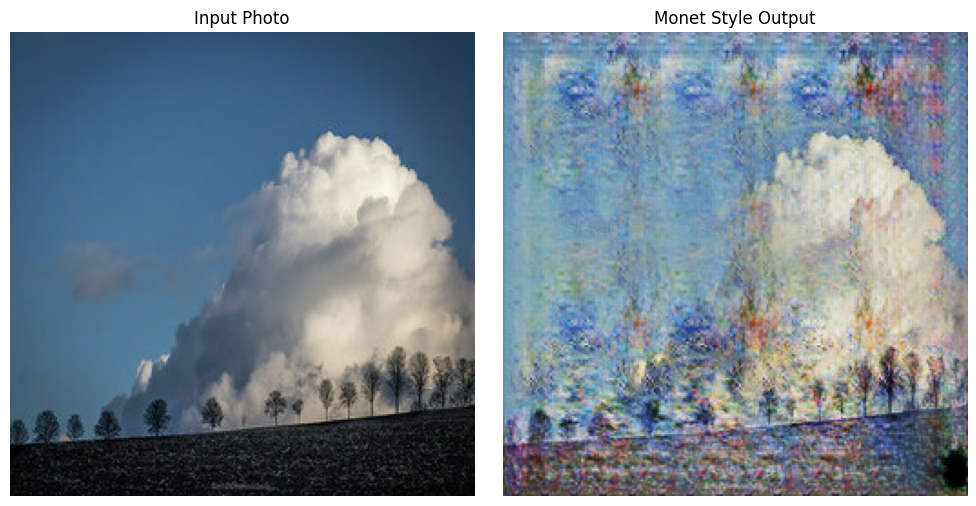


This demonstrates how to use the model once downloaded from Kaggle.
After downloading the zip file, you would:
1. Extract the files
2. Install the requirements: pip install -r requirements.txt
3. Run the FastAPI server: python app.py
4. Access the API at http://localhost:8000 or use the test_api.py script

The API will serve the model and provide endpoints for generating Monet-style images from photos.


In [30]:
# Let's simulate a test of the FastAPI implementation
# In a real scenario, you would run this after downloading the files from Kaggle

# First, let's test that our model works with a sample image
sample_photo = next(iter(photo_ds))
original_output = monet_generator(sample_photo, training=False)[0]

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(sample_photo[0] * 0.5 + 0.5)
plt.title("Input Photo")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(original_output * 0.5 + 0.5)
plt.title("Monet Style Output")
plt.axis("off")

plt.tight_layout()
plt.show()

print("\nThis demonstrates how to use the model once downloaded from Kaggle.")
print("After downloading the zip file, you would:")
print("1. Extract the files")
print("2. Install the requirements: pip install -r requirements.txt")
print("3. Run the FastAPI server: python app.py")
print("4. Access the API at http://localhost:8000 or use the test_api.py script")
print("\nThe API will serve the model and provide endpoints for generating Monet-style images from photos.")